<a href="https://colab.research.google.com/github/wonseokb/Genat4_Study/blob/main/9_More_CNN_Examples(Mar27).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 9. Using CNNs for semantic segmentation: More examples





## Problem 1: Detect and measure zircon grains in microphotographs

<img src="https://onlinelibrary.wiley.com/cms/asset/cb822abf-5e11-4c1e-bc1f-93d63aaee132/dep245-fig-0006-m.jpg" width="600">

Source: Sharman et al., 2018, [detritalPy: A Python-based toolset for visualizing and analysing detrital geo-thermochronologic data, The Depositional Record](https://onlinelibrary.wiley.com/doi/full/10.1002/dep2.45)

<img src="https://raw.githubusercontent.com/zsylvester/GEO391_materials/master/dark_field_zircons.jpeg" width="700">

Zircons from the 1991 eruption of Mount Pinatubo, Phillippines

[Source](https://knowablemagazine.org/article/physical-world/2021/keeping-time-zircons); Image by Fidel Costa and Jorge Vazquez

<img src="https://raw.githubusercontent.com/zsylvester/GEO391_materials/master/zircon_example_1.png" width="700">

Example of a (messy) photomicrograph of detrital zircon grains. Is it possible to get grain size and shape from images like these? Measurements like these would be useful when interpreted in the context of the age of the grains and their likely provenance. Image courtesy of Danny Stockli, UT Austin.

<img src="https://raw.githubusercontent.com/zsylvester/GEO391_materials/master/zircon_example_2.png" width="1000">
Another image; note that it would be difficult to separate the grains by using conventional image segmentation techniques (e.g., thresholding).

<img src="https://raw.githubusercontent.com/zsylvester/GEO391_materials/master/zircon_example_2_mask.png" width="1000">
The same image as above, interpreted manually, using 3 classes: grain, grain boundary, and background.

<img src="https://raw.githubusercontent.com/zsylvester/GEO391_materials/master/zircon_example_3.png" width="1000">
Another example of lots of detrital zircon grains in one image.

<img src="https://raw.githubusercontent.com/zsylvester/GEO391_materials/master/zircon_example_3_mask.png" width="1000">
And the interpretation. This one was pushing my patience to the limits.

### Get the data and break up images into tiles

In [1]:
pip install descartes

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
import os
import time
import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm, trange

from skimage.io import imread, imshow, concatenate_images
from skimage.transform import resize
from skimage.morphology import label, binary_dilation, binary_erosion, reconstruction
from skimage.measure import regionprops, regionprops_table
from skimage import measure
from skimage.segmentation import watershed

from shapely.geometry import Polygon, LineString
from shapely.affinity import scale
from descartes import PolygonPatch

import scipy.ndimage as ndi
import scipy.interpolate

import tensorflow as tf

from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Input, BatchNormalization, Activation, Dense, Dropout
from tensorflow.keras.layers import Lambda, RepeatVector, Reshape
from tensorflow.keras.layers import Conv2D, Conv2DTranspose
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import concatenate, add
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import load_img

In [3]:
!wget https://www.dropbox.com/s/h8vw0lzj7k7n815/Images.zip
!wget https://www.dropbox.com/s/s6uey3d0c06a7cd/Masks.zip
!unzip Images.zip
!unzip Masks.zip

--2023-03-27 19:44:17--  https://www.dropbox.com/s/h8vw0lzj7k7n815/Images.zip
Resolving www.dropbox.com (www.dropbox.com)... 162.125.65.18, 2620:100:6021:18::a27d:4112
Connecting to www.dropbox.com (www.dropbox.com)|162.125.65.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/h8vw0lzj7k7n815/Images.zip [following]
--2023-03-27 19:44:18--  https://www.dropbox.com/s/raw/h8vw0lzj7k7n815/Images.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uca09bb378cfe97cb8486edfca76.dl.dropboxusercontent.com/cd/0/inline/B5C-SSX84mCHgpY9J2tgWwxDaQfp-QiyInsUb30wJlMTkzj6Xi7JXvF1uBtMNm0u34kjIDxAvudW9NDvjOs8arBwHa4NsRlxBNxgWjZVoNe5tW730EIiW9Y-SQcEGvMsylOK5qw2JRfUZ6m0EQE13A7UDQ5FAD1qUwRjvapeVkUY_Q/file# [following]
--2023-03-27 19:44:18--  https://uca09bb378cfe97cb8486edfca76.dl.dropboxusercontent.com/cd/0/inline/B5C-SSX84mCHgpY9J2tgWwxDaQfp-QiyInsUb30wJlMTkzj6Xi7JXvF1uBtMNm0u34kjIDxAvudW9NDvjOs

In [4]:
ls

Images/  Images.zip  __MACOSX/  Masks/  Masks.zip  sample_data/


In [5]:
from glob import glob #for finding files that match a certain string pattern
images = sorted(glob("Images/*.png"))
labels = sorted(glob("Masks/*.png"))

In [6]:
labels

['Masks/06EG_all_2x_3_classes.png',
 'Masks/06EG_all_3_classes.png',
 'Masks/12CCR01_mosaic_2x_3_classes.png',
 'Masks/12CCR01_mosaic_3_classes.png',
 'Masks/12CCR08_mosaic_2x_3_classes.png',
 'Masks/12CCR08_mosaic_3_classes.png',
 'Masks/18YA45_2x_3_classes.png',
 'Masks/18YA45_3_classes.png',
 'Masks/Clift177-13_smooth_2x_3_classes.png',
 'Masks/Clift177-13_smooth_3_classes.png',
 'Masks/ET19TM_15_3_classes.png',
 'Masks/HU_2x_3_classes.png',
 'Masks/HU_3_classes.png']

In [7]:
!mkdir Tiles

In [8]:
cd Tiles

/content/Tiles


In [9]:
!mkdir images
!mkdir labels

In [10]:
cd ..

/content


In [11]:
# break up large images into small squares:
start_no = 0
im_size = 256
for f in images:
  image = np.array(Image.open(f))
  mask = np.array(Image.open(f.replace('Images', 'Masks').replace('.png','_3_classes.png')))
  if len(np.shape(image))==3:
    image = image[:,:,0]
  if len(np.shape(mask))==3:
    mask = mask[:,:,0]
  r, c = np.shape(image)
  n_rows = int(np.floor(r/float(im_size)))
  n_cols = int(np.floor(c/float(im_size)))
  # write files for segmented images:
  for i in trange(n_rows):
      for j in range(n_cols):
          im = image[i*im_size:(i+1)*im_size, j*im_size:(j+1)*im_size].astype('uint8')
          imname = '/content/Tiles/images/' + 'im%03d.png'%(start_no+n_cols*i+j)
          m = mask[i*im_size:(i+1)*im_size, j*im_size:(j+1)*im_size].astype('uint8')
          maskname = '/content/Tiles/labels/' + 'im%03d.png'%(start_no+n_cols*i+j)
          # if np.max(m)>0: # only save images that have more than just background
          im = Image.fromarray(im.astype(np.uint8))
          im.save(imname)
          m = Image.fromarray(m.astype(np.uint8))
          m.save(maskname)
  start_no = start_no + n_rows*n_cols

100%|██████████| 13/13 [00:02<00:00,  5.49it/s]


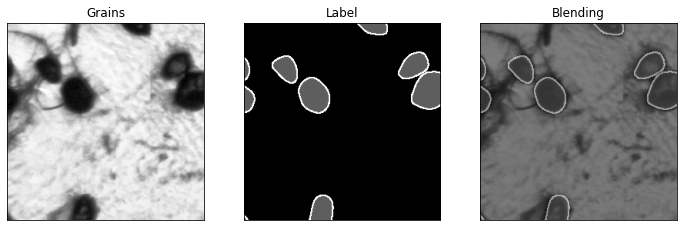

In [12]:
images = sorted(glob("/content/Tiles/images/*.png"))
labels = sorted(glob("/content/Tiles/labels/*.png")) 
import cv2

def plot_images_and_labels(img, label):
  fig = plt.figure(figsize = (12, 4))
  ax1 = fig.add_subplot(131)
  ax1.imshow(img[:,:])
  ax1.set_title("Grains")
  ax1.set_xticks([])
  ax1.set_yticks([])
  ax2 = fig.add_subplot(132)
  ax2.imshow(label[:,:])
  ax2.set_title("Label")
  ax2.set_xticks([])
  ax2.set_yticks([])
  dst = cv2.addWeighted(img, 0.5, label, 0.5, 0)
  ax3 = fig.add_subplot(133)
  ax3.imshow(dst[:,:])
  ax3.set_title("Blending")
  ax3.set_xticks([])
  ax3.set_yticks([])

fname = images[1000]
img = cv2.imread(fname)
mask = cv2.imread(fname.replace('images', 'labels'))
plot_images_and_labels(img, mask)

In [13]:
len(images)

4400

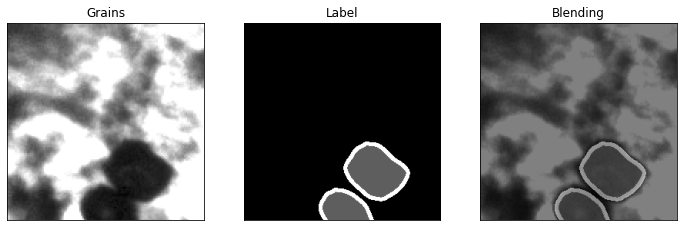

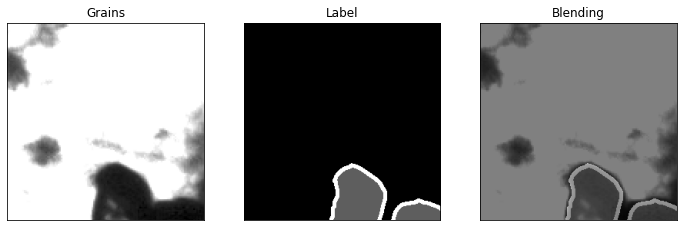

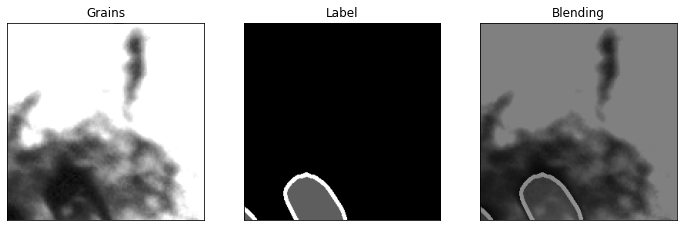

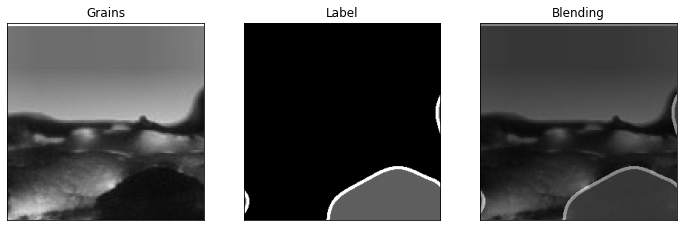

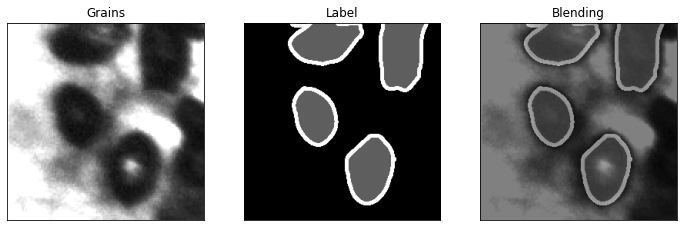

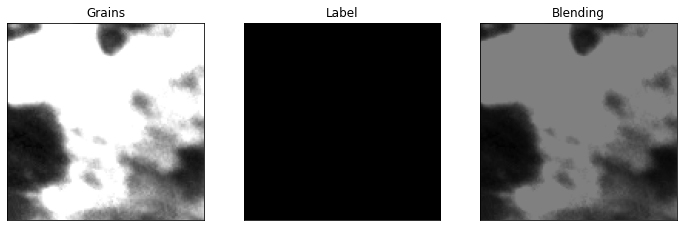

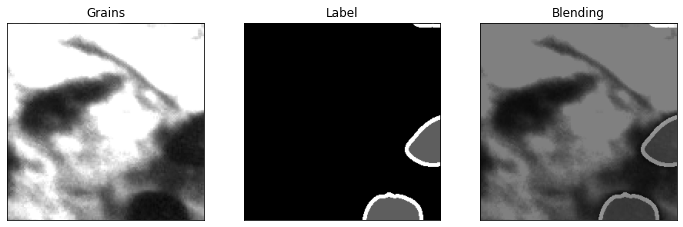

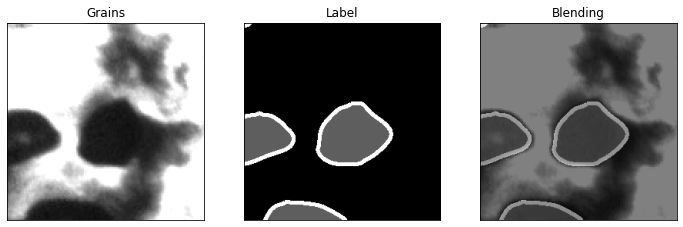

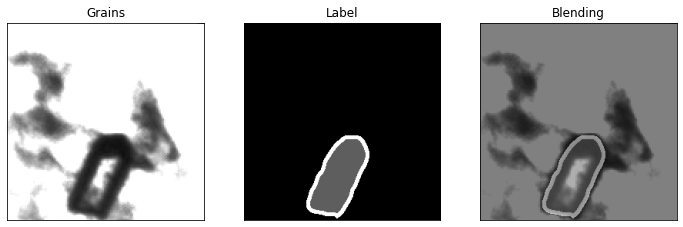

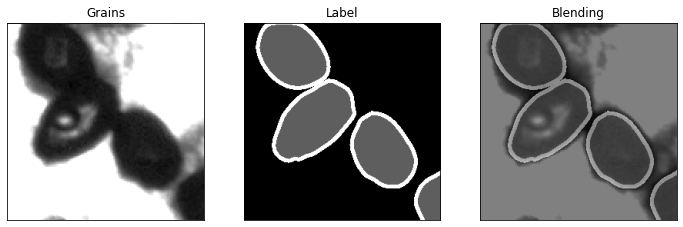

In [14]:
for i in range(504, 514):
  fname = images[i]
  img = cv2.imread(fname)
  mask = cv2.imread(fname.replace('images', 'labels'))
  plot_images_and_labels(img, mask)

### Image augmentation

[CLoDSA](https://github.com/joheras/CLoDSA) is "an open-source image augmentation library for object classification, localization, detection, semantic segmentation and instance segmentation. It supports a wide variety of augmentation techniques and allows the user to easily combine them. It can also be applied to lists of images like videos or z-stacks." Some image augmentation techniques are also built-in parts of Keras and Tensorflow, but they are focused on object classification (as opposed to segmentation). See [this notebook](https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/images/data_augmentation.ipynb) for details on how to do data augmentation in Keras and Tensorflow.

We will use CLoDSA here to apply image augmentation to the grain images and their labels.

In [15]:
!pip install clodsa

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 76.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 276.2/276.2 KB 29.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for clodsa: filename=clodsa-1.2.48-py2.py3-none-any.whl size=74328 sha256=f8f653c7603e3a0e2d96bfea68eee96527cbc9b6aed9a48d57be149e71299a91
  Stored in directory: /root/.cache/pip/wheels/88/81/b1/76a6b831066b6d0610ac18e0d36d822eaefe4986dc81623795
  Created wheel for commentjson: filename=commentjson-0.9.0-py3-none-any.whl size=12097 sha256=feb206ed3f338b5c43d6877d4e35b414ef69b1c6ad9c43625405341a8bfceb02
  Stored in directory: /root/.cache/pip/wheels/ed/0e/3c/ef5ab146764cca41417bcd2493db4f72d8d8c658448317a3fe
  Created wheel for lark-parser: filename=lark_parser-0.7.8-py2.py3-none-any.whl size=625

In [16]:
pip install numpy --upgrade # this is needed so that we are able to run the next cell

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 81.9 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.22.4
    Uninstalling numpy-1.22.4:
      Successfully uninstalled numpy-1.22.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
numba 0.56.4 requires numpy<1.24,>=1.18, but you have numpy 1.24.2 which is incompatible.


In [17]:
from clodsa.augmentors.augmentorFactory import createAugmentor
from clodsa.transformers.transformerFactory import transformerGenerator
from clodsa.techniques.techniqueFactory import createTechnique

RuntimeError: ignored

Could not import submodules (exact error was: numpy.core.multiarray failed to import).

There are many reasons for this error the most common one is that you have
either not built the packages or have built (using `python setup.py build`) or
installed them (using `python setup.py install`) and then proceeded to test
mahotas **without changing the current directory**.

Try installing and then changing to another directory before importing mahotas.


In [18]:
PROBLEM = "semantic_segmentation"
ANNOTATION_MODE = "folders"
INPUT_PATH = "/content/Tiles/"
GENERATION_MODE = "linear" # all the augmentation techniques are applied to all the images of the original dataset
OUTPUT_MODE = "folders"
OUTPUT_PATH= "/content/augmented_images/"
LABELS_EXTENSION = ".png"

augmentor = createAugmentor(PROBLEM, ANNOTATION_MODE, OUTPUT_MODE, GENERATION_MODE, INPUT_PATH,{"outputPath":OUTPUT_PATH,"labelsExtension":LABELS_EXTENSION})

In [19]:
transformer = transformerGenerator(PROBLEM) # initialize a transformer

In [20]:
# rotate images
rot90 = createTechnique("rotate", {"angle" : 90})
augmentor.addTransformer(transformer(rot90))
rot180 = createTechnique("rotate", {"angle" : 180})
augmentor.addTransformer(transformer(rot180))
rot270 = createTechnique("rotate", {"angle" : 270})
augmentor.addTransformer(transformer(rot270))

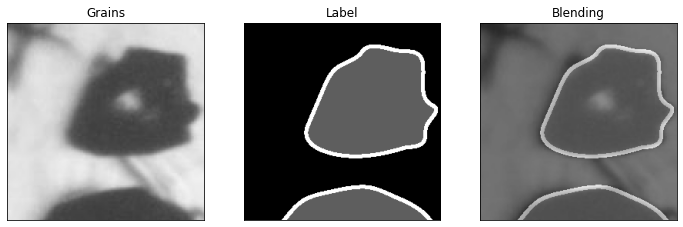

In [21]:
fname = images[2100]
img = cv2.imread(fname)
mask = cv2.imread(fname.replace('images', 'labels'))
plot_images_and_labels(img, mask)

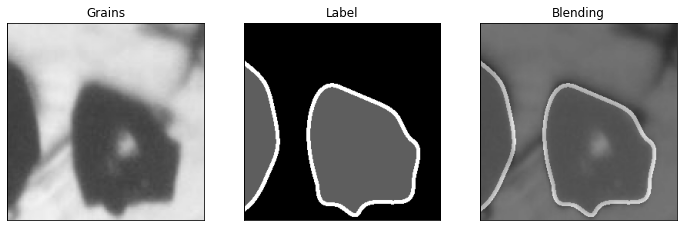

In [22]:
rotationGenerator = transformer(rot90)
rotateImg, rotateLabel = rotationGenerator.transform(img,mask)
plot_images_and_labels(rotateImg, rotateLabel)

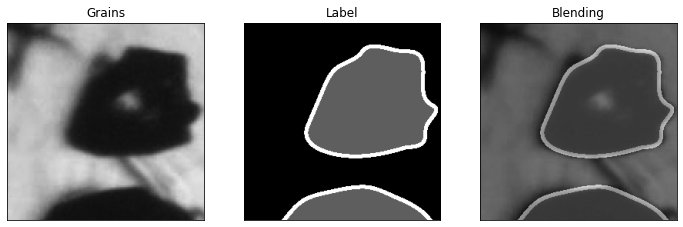

In [89]:
gamma = createTechnique("gamma",{"gamma":0.5})
augmentor.addTransformer(transformer(gamma))
gammaGenerator = transformer(gamma)
gammaImg, gammaLabel = gammaGenerator.transform(img,mask)
plot_images_and_labels(gammaImg, gammaLabel)

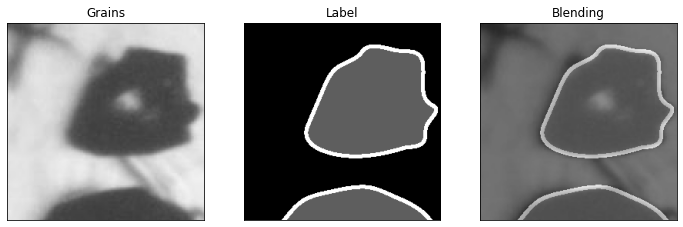

In [90]:
gamma = createTechnique("gamma",{"gamma":1.0})
augmentor.addTransformer(transformer(gamma))
gammaGenerator = transformer(gamma)
gammaImg, gammaLabel = gammaGenerator.transform(img,mask)
plot_images_and_labels(gammaImg, gammaLabel)

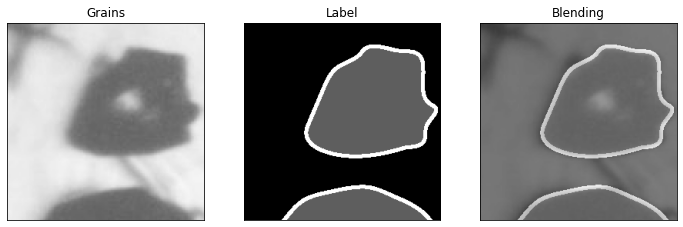

In [91]:
gamma = createTechnique("gamma",{"gamma":1.5})
augmentor.addTransformer(transformer(gamma))
gammaGenerator = transformer(gamma)
gammaImg, gammaLabel = gammaGenerator.transform(img,mask)
plot_images_and_labels(gammaImg, gammaLabel)

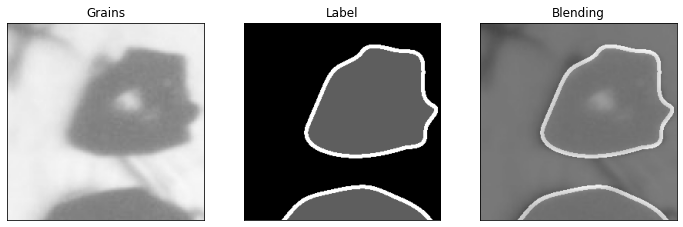

In [92]:
gamma1 = createTechnique("gamma",{"gamma":2.0})
augmentor.addTransformer(transformer(gamma1))
gammaGenerator = transformer(gamma1)
gammaImg,gammaLabel = gammaGenerator.transform(img,mask)
plot_images_and_labels(gammaImg, gammaLabel)

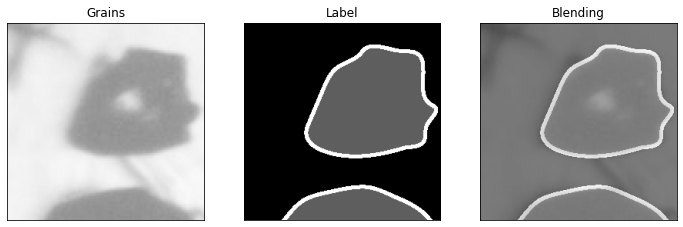

In [93]:
gamma2 = createTechnique("gamma",{"gamma":2.5})
augmentor.addTransformer(transformer(gamma2))
gammaGenerator = transformer(gamma2)
gammaImg,gammaLabel = gammaGenerator.transform(img,mask)
plot_images_and_labels(gammaImg, gammaLabel)

In [94]:
none = createTechnique("none",{}) # need to copy the original images as well!
augmentor.addTransformer(transformer(none))

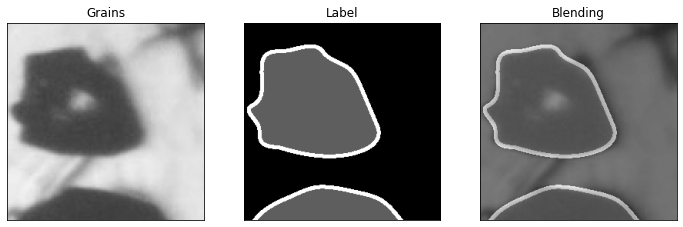

In [95]:
fliph = createTechnique("flip",{"flip":1})
flipv = createTechnique("flip",{"flip":0})
augmentor.addTransformer(transformer(fliph))
augmentor.addTransformer(transformer(flipv))
flipGenerator = transformer(fliph)
flipImg, flipLabel = flipGenerator.transform(img,mask)
plot_images_and_labels(flipImg, flipLabel)

In [96]:
len(augmentor.transformers) # we have created 9 transformers: 3 rotations, 3 gamma transformations, 2 flips, and the original images

27

In [97]:
augmentor.applyAugmentation() # apply the augmentation; this takes a while

In [98]:
from glob import glob 
images = sorted(glob("/content/augmented_images/images/*.png"))
labels = sorted(glob("/content/augmented_images/labels/*.png")) 

In [70]:
len(images)

83600

### Compile, train, and test Unet model

In [99]:
# split half into training
train_idx = np.random.choice(np.arange(len(images)), size = int(len(images)/2) , replace=False)
# get the rest
idx = np.setdiff1d(np.arange(len(images)), train_idx)
# get val files (25% of total)
val_idx = np.random.choice(idx, size = int(len(images)/4) , replace=False)
# get test files (25% of total)
test_idx = np.setdiff1d(val_idx, train_idx)

In [100]:
def image_batch_generator(files, im_size, batch_size = 8):
  
  while True: # this is here because it will be called repeatedly by the training function
    
    # extract a random subset of files of length "batch_size"
    batch = np.random.choice(files, size = batch_size)    
    
    # variables for collecting batches of inputs (x) and outputs (y)
    batch_x = []
    batch_y = []
    
    #cycle through each image in the batch
    for f in batch:
        # open the image and resize
        image = np.array(Image.open(f))
        image = image[:,:,0]/255.0 # scale input image to (0, 1)
        image = np.expand_dims(image,2)
        batch_x.append(image) 

        # open label image by string substitution
        mask = np.array(Image.open(f.replace('/images/','/labels/')))
        mask = mask[:,:,0]
        temp = np.zeros((im_size, im_size, 3)) # create expanded target with channels for 3 classes
        temp[:,:,0][mask==0] = 1 # background
        temp[:,:,1][mask==94] = 1 # grain
        temp[:,:,2][mask==255] = 1 # boundary
        mask = temp
        batch_y.append(mask)

    # turn into numpy arrays
    batch_x = np.array(batch_x) 
    batch_y = np.array(batch_y)

    yield (batch_x, batch_y) #yield both the image and the label together

In [101]:
gen = image_batch_generator(images, im_size = 256, batch_size = 8)

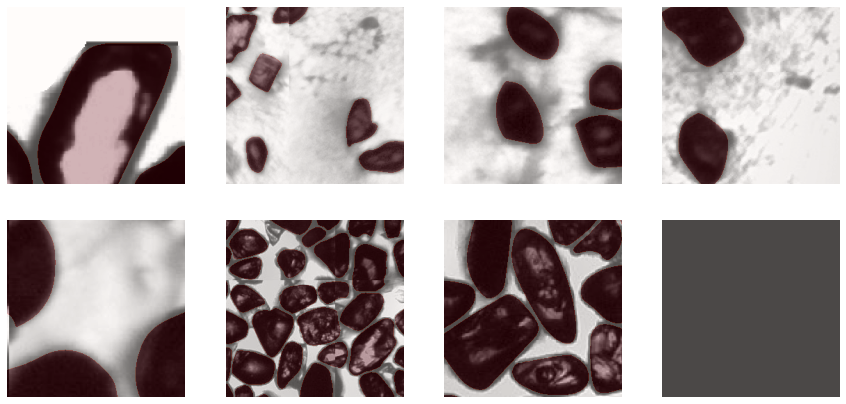

In [102]:
x1, y1 = next(gen)

plt.figure(figsize=(15,15))

counter = 0
for k in range(8):
  plt.subplot(4,4,counter+1)
  plt.imshow(x1[counter][:,:,0],  cmap=plt.cm.gray)
  plt.imshow(y1[counter][:,:,1], alpha=0.3, cmap=plt.cm.Reds)
  plt.axis('off')
  counter += 1

In [103]:
np.shape(x1[0]) # image

(256, 256, 1)

In [104]:
np.shape(y1[0]) # label

(256, 256, 3)

In [105]:
# create arrays of training, validation, and test files (these are filenames)
train_files = np.array(images)[train_idx]
val_files = np.array(images)[val_idx]
test_files = np.array(images)[test_idx]

In [106]:
train_files[:5]

array(['/content/augmented_images/images/3117_20_im4179.png',
       '/content/augmented_images/images/3505_14_im1644.png',
       '/content/augmented_images/images/4112_16_im968.png',
       '/content/augmented_images/images/4236_23_im1616.png',
       '/content/augmented_images/images/2472_17_im240.png'], dtype='<U51')

In [107]:
im_size = 256
batch_size = 64
train_generator = image_batch_generator(train_files, im_size, batch_size = batch_size) # call the batch generator for train set
val_generator  = image_batch_generator(val_files, im_size, batch_size = batch_size) # call batch generator validation set
train_steps = len(train_files)//batch_size # number of steps per training epoch
val_steps = len(val_files)//batch_size # number of steps per validation epoch
print(train_steps)
print(val_steps)

928
464


In [108]:
# get an idea about class balance
background_fractions = []
grain_fractions = []
boundary_fractions = []                  
count = 0
while count < 100:
  x1, y1 = next(gen)
  for i in range(8):
    boundary_fraction = len(np.where(y1[i][:,:,2]==1)[0])/(256**2)
    grain_fraction = len(np.where(y1[i][:,:,1]==1)[0])/(256**2)
    grain_fractions.append(grain_fraction)
    boundary_fractions.append(boundary_fraction)
    background_fractions.append(1 - grain_fraction - boundary_fraction)
  count += 1 

In [109]:
print(1/(3*np.mean(background_fractions)), 1/(3*np.mean(grain_fractions)), 1/(3*np.mean(boundary_fractions)))
# background, grain, boundary

0.47740012739217264 1.3312137021410355 6.4881620199077155


In [110]:
def weighted_crossentropy(y_true, y_pred):
    class_weights = tf.constant([[[[0.47, 1.37, 6.38]]]]) # increase the weight on the grains and the grain boundaries
    unweighted_losses = tf.nn.softmax_cross_entropy_with_logits(labels=y_true, logits=y_pred)
    weights = tf.reduce_sum(class_weights * y_true, axis=-1) # sum of weights
    weighted_losses = weights * unweighted_losses # weighted losses
    loss = tf.reduce_mean(weighted_losses) # mean loss
    return loss

In [111]:
def Unet():
    tf.keras.backend.clear_session()

    image = tf.keras.Input((256,256,1),name='input')

    conv1 = Conv2D(16, (3,3), activation='relu', padding = 'same')(image)
    conv1 = BatchNormalization()(conv1)

    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv2 = Conv2D(32, (3,3), activation='relu', padding = 'same')(pool1)
    conv2 = BatchNormalization()(conv2)

    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(64, (3,3), activation='relu', padding = 'same')(pool2)
    conv3 = BatchNormalization()(conv3)

    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv4 = Conv2D(128, (3,3), activation='relu', padding = 'same')(pool3)
    conv4 = BatchNormalization()(conv4)

    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)
    conv5 = Conv2D(256, (3,3), activation='relu', padding = 'same')(pool4)
    conv5 = BatchNormalization()(conv5)

    up6 = Conv2DTranspose(128, (3, 3), strides = (2, 2), padding = 'same')(conv5)
    up6 = concatenate([up6, conv4])
    conv6 = Conv2D(128, (3,3), activation='relu', padding = 'same')(up6)
    conv6 = BatchNormalization()(conv6)

    up7 = Conv2DTranspose(64, (3, 3), strides = (2, 2), padding = 'same')(conv6)
    up7 = concatenate([up7, conv3])
    conv7 = Conv2D(64, (3,3), activation='relu', padding = 'same')(up7)
    conv7 = BatchNormalization()(conv7)

    up8 = Conv2DTranspose(32, (3, 3), strides = (2, 2), padding = 'same')(conv7)
    up8 = concatenate([up8, conv2])
    conv8 = Conv2D(32, (3,3), activation='relu', padding = 'same')(up8)
    conv8 = BatchNormalization()(conv8)

    up9 = Conv2DTranspose(16, (3, 3), strides = (2, 2), padding = 'same')(conv8)
    up9 = concatenate([up9, conv1])
    conv9 = Conv2D(16, (3,3), activation='relu', padding = 'same')(up9)
    conv9 = BatchNormalization()(conv9)

    conv10 = Conv2D(3, (1,1), activation='softmax')(conv9)
    model = Model(inputs=[image], outputs=[conv10])

    return model

In [112]:
model = Unet()
loss = weighted_crossentropy
model.compile(optimizer=Adam(), loss=loss, metrics=["accuracy"])

In [113]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input (InputLayer)             [(None, 256, 256, 1  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 16  160         ['input[0][0]']                  
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 256, 256, 16  64         ['conv2d[0][0]']                 
 alization)                     )                                                             

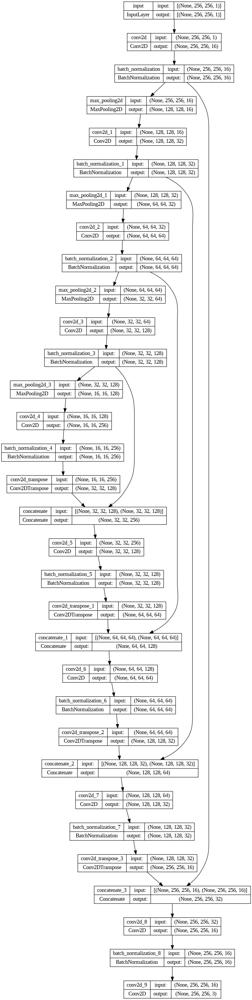

In [114]:
from keras.utils import plot_model
plot_model(model,show_shapes=True)

In [115]:
callbacks = [
    EarlyStopping(patience=5, verbose=1),
    ReduceLROnPlateau(factor=0.1, patience=5, min_lr=0.00001, verbose=1),
    ModelCheckpoint('model_1.h5', verbose=1, save_best_only=True, save_weights_only=True)
]

In [116]:
results = model.fit(train_generator, 
                epochs = 100, steps_per_epoch = train_steps,
                validation_data = val_generator, validation_steps = val_steps,
                callbacks = callbacks)	

Epoch 1/100
928/928 [==============================] - ETA: 0s - loss: 0.7103 - accuracy: 0.8539
Epoch 1: val_loss improved from inf to 0.69176, saving model to model_1.h5
928/928 [==============================] - 548s 584ms/step - loss: 0.7103 - accuracy: 0.8539 - val_loss: 0.6918 - val_accuracy: 0.8889 - lr: 0.0010
Epoch 2/100
928/928 [==============================] - ETA: 0s - loss: 0.6696 - accuracy: 0.8972
Epoch 2: val_loss improved from 0.69176 to 0.67234, saving model to model_1.h5
928/928 [==============================] - 537s 579ms/step - loss: 0.6696 - accuracy: 0.8972 - val_loss: 0.6723 - val_accuracy: 0.8949 - lr: 0.0010
Epoch 3/100
928/928 [==============================] - ETA: 0s - loss: 0.6616 - accuracy: 0.9060
Epoch 3: val_loss did not improve from 0.67234
928/928 [==============================] - 536s 578ms/step - loss: 0.6616 - accuracy: 0.9060 - val_loss: 0.6995 - val_accuracy: 0.8888 - lr: 0.0010
Epoch 4/100
928/928 [==============================] - ETA: 0s -

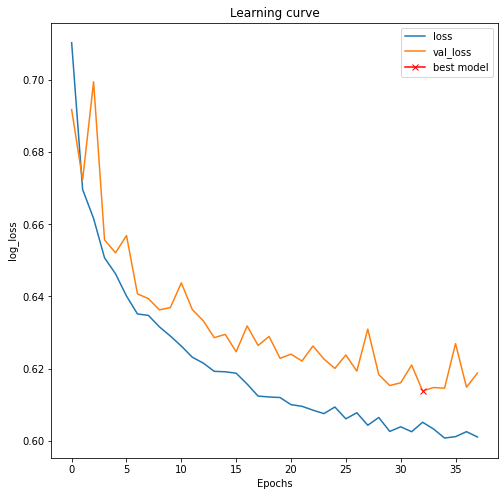

In [117]:
# with batch normalization
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(results.history["loss"], label="loss")
plt.plot(results.history["val_loss"], label="val_loss")
plt.plot(np.argmin(results.history["val_loss"]), np.min(results.history["val_loss"]), marker="x", color="r", label="best model")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend();

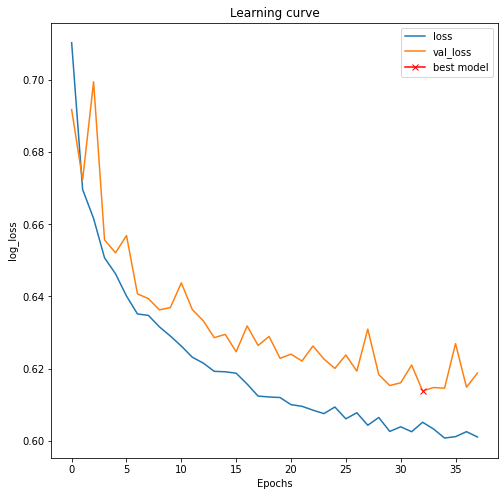

In [118]:
# without batch normalization
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(results.history["loss"], label="loss")
plt.plot(results.history["val_loss"], label="val_loss")
plt.plot(np.argmin(results.history["val_loss"]), np.min(results.history["val_loss"]), marker="x", color="r", label="best model")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend();

In [ ]:
# load the best model
model=Unet()
model.load_weights('model_1.h5')
loss = weighted_crossentropy
model.compile(optimizer=Adam(), loss=loss, metrics=["accuracy"])

In [ ]:
test_generator = image_batch_generator(test_files, im_size, batch_size = batch_size)
print("# test files: %i" % (len(test_files)))
# some other training parameters
steps = len(test_files) // batch_size
# testing
scores = model.evaluate(test_generator, steps=steps) 

In [ ]:
print(model.metrics_names)
print(scores)

In [ ]:
print(model.metrics_names)
print(scores)

In [ ]:
!wget https://www.dropbox.com/s/4sr2buztl9j5uzt/model_1_zircon_w_batchnorm_2023.h5

In [ ]:
model.load_weights('model_1_zircon_w_batchnorm_2023.h5') # load model weights from saved file

Load some images that were not used in training:

In [ ]:
!wget https://www.dropbox.com/s/q0y8dyrocfnip22/Images_not_used_in_training.zip
!unzip Images_not_used_in_training.zip

### Post-processing

**Edge effects**

Most images that we want to segment are much larger than 256 x 256 pixels, so we need to break them up into 256 x 256 tiles to apply the model and then reassemble the large image. However, this results in edge effects at the boundaries between the tiles, which might not be obvious at first sight, but they are definitely a problem if you want precise results. In the next section we look at one way of dealing with these edge effects.

In [ ]:
# function for segmenting one tile:
def predict_image_tile(im_tile, model):
    im_tile = np.expand_dims(im_tile, axis = 2) # add dimension for channel
    im_tile = np.expand_dims(im_tile, axis = 0) # add dimension for batch
    return model.predict(im_tile, verbose = 0)[0]

# load an large image and apply segmentation to two neighboring tiles:
big_im = np.array(load_img('Images_not_used_in_training/VE1906B.jpg', color_mode = 'grayscale'))
r1 = 600
c1 = 400
im_tile = big_im[r1:r1+256, c1:c1+256]/255
im_tile_pred1 = predict_image_tile(im_tile, model) # tile 1
im_tile = big_im[r1:r1+256, c1+256:c1+2*256]/255
im_tile_pred2 = predict_image_tile(im_tile, model) # tile
im_tile_pred = np.concatenate((im_tile_pred1, im_tile_pred2), axis = 1)
fig = plt.figure(figsize = (20, 20))
plt.imshow(im_tile_pred[:,:,1])
plt.plot([256, 256], [0, 256], 'r--', linewidth = 2)
plt.ylim(0,256);

One way to deal with these edge effects in patch-based image segmentation is to use the [Hann window function](https://en.wikipedia.org/wiki/Hann_function), often used in signal processing. See [this paper](https://journals.plos.org/plosone/article?id=10.1371/journal.pone.0229839) for more details.

In [ ]:
I = 256
han1 = np.zeros((128+256,))
han1[:256] = np.hanning(I)
han2 = np.zeros((128+256,))
han2[128:] = np.hanning(I)
plt.plot(han1)
plt.plot(han2)
plt.plot(han1 + han2)
plt.xlim(0, 256+128)
plt.ylim(0, 1.1);

In [ ]:
I = 256
W = np.tile(np.hanning(I), (I, 1))
plt.imshow(W)
plt.colorbar();

In [ ]:
big_im = np.array(load_img('Images_not_used_in_training/VE1906B.jpg', color_mode = 'grayscale'))
r1 = 600
c1 = 400
im_tile = big_im[r1:r1+256, c1:c1+256]/255
im_tile_pred1 = predict_image_tile(im_tile, model) # tile 1
im_tile = big_im[r1:r1+256, c1+256:c1+2*256]/255
im_tile_pred2 = predict_image_tile(im_tile, model) # tile 2
# multiply segmented tiles by Hanning window:
im_tile_pred = np.concatenate((W * im_tile_pred1[:,:,1], W * im_tile_pred2[:,:,1]), axis = 1)
fig = plt.figure(figsize = (20, 20))
plt.imshow(im_tile_pred)
plt.plot([256, 256], [0, 256], 'r--', linewidth = 2)
plt.ylim(0,256);

In [ ]:
# edge effects
big_im = np.array(load_img('Images_not_used_in_training/VE1906B.jpg', color_mode = 'grayscale'))
r1 = 600
c1 = 400
im_tile = big_im[r1:r1+256, c1:c1+256]/255
im_tile_pred1 = predict_image_tile(im_tile, model) # tile 1
im_tile = big_im[r1:r1+256, c1+256:c1+2*256]/255
im_tile_pred2 = predict_image_tile(im_tile, model) # tile 2
im_tile = big_im[r1:r1+256, c1+128:c1+384]/255
im_tile_pred3 = predict_image_tile(im_tile, model) # tile 3
# multiply segmented tiles by Hanning window:
im_tile_pred = np.concatenate((W * im_tile_pred1[:,:,1], W * im_tile_pred2[:,:,1]), axis = 1)
# add third tile to the middle of the image:
im_tile_pred[:, 128:128+256] += W * im_tile_pred3[:,:,1]
fig = plt.figure(figsize = (20, 20))
plt.imshow(im_tile_pred)
plt.plot([256, 256], [0, 256], 'r--', linewidth = 2)
plt.ylim(0,256);

In [ ]:
I = 256
W = np.hanning(I) * np.hanning(I)[:, np.newaxis]
fig = plt.figure(figsize = (10, 4))
ax1 = fig.add_subplot(131)
im = ax1.imshow(W)
ax1.set_title('W')
ax1.set_xticks([])
ax1.set_yticks([])
I2 = int(I/2)
W = np.hanning(I) * np.hanning(I)[:, np.newaxis]
Wup = W.copy()
Wup[:I2, :] = np.tile(np.hanning(I), (I2, 1))
ax2 = fig.add_subplot(132)
im = ax2.imshow(Wup)
ax2.set_title('Wup')
ax2.set_xticks([])
ax2.set_yticks([])
Wdown = W.copy()
Wdown[I2:, :] = np.tile(np.hanning(I), (I2, 1))
ax3 = fig.add_subplot(133)
im = ax3.imshow(Wdown)
ax3.set_title('Wdown')
ax3.set_xticks([])
ax3.set_yticks([]);

In [ ]:
len(np.shape(big_im))

In [ ]:
from skimage.measure import regionprops, regionprops_table
from skimage.morphology import binary_dilation, binary_erosion
from shapely.geometry import Polygon, LineString
from shapely.affinity import scale
from descartes import PolygonPatch
from skimage.morphology import reconstruction
import scipy.ndimage as ndi
from skimage import measure
from skimage.segmentation import watershed
from shapely.geometry import Polygon
import scipy.interpolate
import math
from matplotlib.colors import ListedColormap


#  functions for assembling big image from prediction tiles:
def predict_image_tile(im_tile,model):
    if len(np.shape(big_im)) == 2:
      im_tile = np.expand_dims(im_tile, axis = 2) # add dimension for channel
    im_tile = np.expand_dims(im_tile, axis = 0) # add dimension for batch
    return model.predict(im_tile, verbose=0)[0]

def predict_big_image(big_im, model, I):
    pad_rows = I - np.mod(big_im.shape[0], I)
    pad_cols = I - np.mod(big_im.shape[1], I)
    if len(np.shape(big_im)) == 2:
      big_im = np.vstack((big_im, np.zeros((pad_rows, big_im.shape[1]))))
      big_im = np.hstack((big_im, np.zeros((big_im.shape[0], pad_cols))))
    if len(np.shape(big_im)) == 3:
      big_im = np.vstack((big_im, np.zeros((pad_rows, big_im.shape[1], big_im.shape[2]))))
      big_im = np.hstack((big_im, np.zeros((big_im.shape[0], pad_cols, big_im.shape[2]))))
    r = int(np.floor(big_im.shape[0]/I)) # number of rows of image tiles
    c = int(np.floor(big_im.shape[1]/I)) # number of columns of image tiles

    I2 = int(I/2)
    W = np.hanning(I) * np.hanning(I)[:, np.newaxis]
    Wup = W.copy()
    Wup[:I2, :] = np.tile(np.hanning(I), (I2, 1))
    Wdown = W.copy()
    Wdown[I2:, :] = np.tile(np.hanning(I), (I2, 1))

    if len(np.shape(big_im)) == 2:
      big_im = np.hstack((np.zeros((r*I, I2)), big_im, np.zeros((r*I, I2)))) # padding on the left and right sides
    if len(np.shape(big_im)) == 3:
      big_im = np.hstack((np.zeros((r*I, I2, 3)), big_im, np.zeros((r*I, I2, 3)))) # padding on the left and right sides
    big_im_pred = np.zeros((big_im.shape[0], big_im.shape[1], 3))

    for i in trange(c+1): # rows, no offset
      for j in range(1,2*r-2): # columns
        im_tile = big_im[j*I2:(j+2)*I2, i*I:(i+1)*I]/255.0
        im_tile_pred = predict_image_tile(im_tile, model)
        for layer in range(3):
          big_im_pred[j*I2:(j+2)*I2, i*I:(i+1)*I, layer] += im_tile_pred[:, :, layer] * W
    for i in range(c+1): # first row
      im_tile = big_im[:2*I2, i*I:(i+1)*I]/255.0
      im_tile_pred = predict_image_tile(im_tile, model)
      for layer in range(3):
        big_im_pred[:2*I2, i*I:(i+1)*I, layer] += im_tile_pred[:, :, layer] * Wup
    for i in range(c+1): # last row
      im_tile = big_im[(2*r-2)*I2:2*r*I2, i*I:(i+1)*I]/255.0
      im_tile_pred = predict_image_tile(im_tile,model)
      for layer in range(3):
        big_im_pred[(2*r-2)*I2:2*r*I2, i*I:(i+1)*I, layer] += im_tile_pred[:, :, layer] * Wdown

    for i in trange(c): # rows, half offset
      for j in range(1,2*r-2): # columns
        im_tile = big_im[j*I2:(j+2)*I2, i*I+I2:(i+1)*I+I2]/255.0
        im_tile_pred = predict_image_tile(im_tile,model)
        for layer in range(3):
          big_im_pred[j*I2:(j+2)*I2, i*I+I2:(i+1)*I+I2, layer] += im_tile_pred[:, :, layer] * W
    for i in range(c): # first row
      im_tile = big_im[:2*I2, i*I+I2:(i+1)*I+I2]/255.0
      im_tile_pred = predict_image_tile(im_tile,model)
      for layer in range(3):
        big_im_pred[:2*I2, i*I+I2:(i+1)*I+I2, layer] += im_tile_pred[:, :, layer] * Wup
    for i in range(c): # last row
      im_tile = big_im[(2*r-2)*I2:2*r*I2, i*I+I2:(i+1)*I+I2]/255.0
      im_tile_pred = predict_image_tile(im_tile,model)
      for layer in range(3):
        big_im_pred[(2*r-2)*I2:2*r*I2, i*I+I2:(i+1)*I+I2, layer] += im_tile_pred[:, :, layer] * Wdown

    big_im_pred = big_im_pred[:, I2:-I2, :] # crop the left and right side padding
    big_im_pred = big_im_pred[:-pad_rows, :-pad_cols, :] # get rid of padding
    return big_im_pred

def split_grains(im, selem_size):
    n_elems = 1
    eroded = im.copy()
    while (n_elems<2) & (1 in np.unique(eroded)):
        selem = np.ones((selem_size,selem_size))
        eroded = binary_erosion(eroded, selem = selem)
        temp_labels, n_elems = measure.label(eroded, return_num = True)
        obj_features = regionprops(temp_labels)
        for i in range(len(obj_features)):
            if obj_features[i]['area'] < 10:
                eroded[temp_labels==i+1] = 0
        temp_labels, n_elems = measure.label(eroded, return_num = True)
        selem_size += 1
    if np.max(eroded)>0:
        distance = ndi.distance_transform_edt(eroded)
        rs = []; cs = []
        # for i in range(n_elems+1):
        for i in range(n_elems):
            dist1 = distance.copy()
            dist1[temp_labels != i+1] = 0
            r, c = np.unravel_index(np.argmax(dist1), np.shape(im))
            rs.append(r)
            cs.append(c)
        markers = np.zeros(np.shape(im))
        # for i in range(n_elems+1):
        for i in range(n_elems):
            markers[rs[i],cs[i]] = i+1
        distance = ndi.distance_transform_edt(im)
        gr_labels = watershed(-distance, markers, mask=im)
    else:
        gr_labels = im.copy()
    return gr_labels, eroded

def split_all_grains(ind, object_features, filled, labels, selem_size):
    minrow, mincol, maxrow, maxcol = object_features[ind]["bbox"]
    im = filled[max(0,minrow-2):maxrow+2,max(0,mincol-2):maxcol+2].copy()
    im[labels[max(0,minrow-2):maxrow+2,max(0,mincol-2):maxcol+2] != ind+1] = 0
    if maxcol >= filled.shape[1]:
      im = np.hstack((im, np.zeros((im.shape[0],2))))
    result, eroded = split_grains(im, selem_size)
    im[result==2] = 2
    start = time.time()
    while np.max(result)>1:
      if len(result[result==2]) > len(result[result==1]):
        result[result==1] = 0
        result[result==2] = 1
      else:
        result[result==1] = 1
        result[result==2] = 0
      result, eroded = split_grains(result, selem_size)
      im[result==2] = np.max(im)+1
      if time.time() - start > 1.0: # There are objects where this loop gets stuck. We don't want that.
        break
    return im

def compute_curvature(x,y):
    """function for computing first derivatives and curvature of a curve (centerline)
    x,y are cartesian coodinates of the curve
    outputs:
    dx - first derivative of x coordinate
    dy - first derivative of y coordinate
    ds - distances between consecutive points along the curve
    s - cumulative distance along the curve
    curvature - curvature of the curve (in 1/units of x and y)"""
    dx = np.gradient(x) # first derivatives
    dy = np.gradient(y)      
    ddx = np.gradient(dx) # second derivatives 
    ddy = np.gradient(dy) 
    curvature = (dx*ddy-dy*ddx)/((dx**2+dy**2)**1.5)
    return curvature

def get_grain_axes(poly):
    if (type(poly) == Polygon) and (type(poly.minimum_rotated_rectangle) == Polygon):
        mbr_points = list(zip(*poly.minimum_rotated_rectangle.exterior.coords.xy))
        # calculate the length of each side of the minimum bounding rectangle
        mbr_lengths = [LineString((mbr_points[i], mbr_points[i+1])).length for i in range(len(mbr_points) - 1)]
        # get major/minor axis measurements
        minor_axis = min(mbr_lengths)
        major_axis = max(mbr_lengths)
        mrb = poly.minimum_rotated_rectangle
    else:
        minor_axis = np.nan
        major_axis = np.nan
        mrb = None
    return minor_axis, major_axis, mrb

def label_and_dilate_grains(big_im, big_im_pred, small_grain_threshold, dilate_size, selem_size, splitting):
    # separate objects through labeling image regions
    boundary = (big_im_pred[:,:,2] > 0.5).astype(np.uint8) # set this to 0.95 to minimize false positives
    boundary[big_im_pred[:,:,0] > 0.5] = 1 # set this to 0.05 to minimize false positives

    labels, n_labels = label(boundary, background=1, return_num=True) # object labeling
    object_features = regionprops(labels)
    object_areas = [objf["area"] for objf in object_features]
    # find the indices of small objects:
    small_obj_inds = np.where(np.array(object_areas)<small_grain_threshold)[0]+1
    count = 0
    for ind in tqdm(small_obj_inds):  # this can take a long time for a large image!
      labels[labels == ind] = 0
      count += 1

    # fill holes:
    labels[labels>0] = 1
    seed = np.copy(labels)
    seed[1:-1, 1:-1] = labels.max()
    filled = reconstruction(seed, labels, method='erosion')

    labels, n_labels = label(filled, return_num = True) # re-label image
    object_features = regionprops(labels)

    n_grains = n_labels
    new_labels = labels.copy() # new labels for split grain clusters
    if splitting == True:
        for ind in trange(n_labels):
            minrow, mincol, maxrow, maxcol = object_features[ind]["bbox"]
            im = filled[max(0,minrow-2):maxrow+2,max(0,mincol-2):maxcol+2].copy()
            im[labels[max(0,minrow-2):maxrow+2,max(0,mincol-2):maxcol+2] != ind+1] = 0
            if maxcol >= filled.shape[1]:
              im = np.hstack((im, np.zeros((im.shape[0],2))))

            im = split_all_grains(ind, object_features, filled, labels, selem_size)
            if np.max(im)>1:
              for i in range(2,int(np.max(im)+1)):
                if maxcol >= filled.shape[1]:
                  im = im[:,:-2]
                new_labels[max(0,minrow-2):maxrow+2,max(0,mincol-2):maxcol+2][im == i] = n_grains+1
                n_grains += 1

    object_features = regionprops(new_labels)

    new_labels_dilated = new_labels.copy()
    for ind in trange(len(object_features)):
      minrow, mincol, maxrow, maxcol = object_features[ind]["bbox"]
      pad = 10
      im = new_labels[max(0,minrow-pad):maxrow+pad,max(0,mincol-pad):maxcol+pad].copy()
      im[new_labels[max(0,minrow-pad):maxrow+pad,max(0,mincol-pad):maxcol+pad] != object_features[ind]["label"]] = 0
      im[im>0] = 1
      grain_dist = ndi.distance_transform_edt(1 - im)
      temp = np.ones(np.shape(im))
      temp[grain_dist > dilate_size] = 0
      im = temp
      im[im==1] = ind+1
      new_labels_dilated[max(0,minrow-pad):maxrow+pad,max(0,mincol-pad):maxcol+pad][im==ind+1] = im[im==ind+1]

    props = regionprops_table(new_labels_dilated, intensity_image = big_im, properties=('label', 'area', 'centroid', 'major_axis_length', 'minor_axis_length', 
                                                                                        'orientation', 'perimeter', 'max_intensity', 'mean_intensity', 'min_intensity'))
    grain_data = pd.DataFrame(props)

    print('plotting...')
    # create colormap with random colors, first color white (for background)
    colors = []
    for i in range(n_grains):
      l = list(np.random.random(3))
      l.append(1)
      colors.append(l)
    colors[0] = [1,1,1,0]
    cmap = ListedColormap(colors)

    xs, ys = create_grain_outlines(big_im, new_labels_dilated)

    fig = plt.figure(figsize=(30,20))
    plt.imshow(big_im, cmap='gray', interpolation=None)
    plt.imshow(new_labels_dilated, cmap=cmap, interpolation=None, alpha=0.4);
    for i in range(len(grain_data['label'])):
        # if type(xs[i]) == np.ndarray:
        plt.plot(xs[i], ys[i],'k', linewidth = 1.0)
    plt.xticks([])
    plt.yticks([])
    plt.xlim([0, np.shape(big_im)[1]])
    plt.ylim([np.shape(big_im)[0], 0])
    plt.tight_layout()
 
    return new_labels_dilated, grain_data, xs, ys

def create_grain_outlines(big_im, new_labels_dilated):
    object_features = regionprops(new_labels_dilated)
    filled = new_labels_dilated.copy()
    filled[filled>0] = 1
    n_grains = len(object_features)
    xs = []
    ys = []
    for ind in range(n_grains):
        minrow, mincol, maxrow, maxcol = object_features[ind]["bbox"]
        im = filled[max(0,minrow-2):maxrow+2,max(0,mincol-2):maxcol+2].copy()
        im[new_labels_dilated[max(0,minrow-2):maxrow+2,max(0,mincol-2):maxcol+2] != object_features[ind]["label"]] = 0
        if maxcol >= filled.shape[1]:
            im = np.hstack((im, np.zeros((im.shape[0],2))))
        contours = measure.find_contours(im, 0.5)
        sx = contours[0][:,1]
        sy = contours[0][:,0]
        xs.append(sx+mincol - 2 + 0.5)
        ys.append(sy+minrow - 2 + 0.5)
    return xs, ys

def compute_s_coordinates(x, y):
  dx = np.gradient(x) # first derivatives
  dy = np.gradient(y)   
  ds = np.sqrt(dx**2+dy**2)
  s = np.hstack((0,np.cumsum(ds[1:])))
  return s

def get_grain_curvature(big_im, labels, regions, ind):
  filled = labels.copy()
  filled[filled>0] = 1
  minrow, mincol, maxrow, maxcol = regions[ind].bbox
  im = filled[max(0,minrow-2):maxrow+2,max(0,mincol-2):maxcol+2].copy()
  im[labels[max(0,minrow-2):maxrow+2,max(0,mincol-2):maxcol+2] != regions[ind]["label"]] = 0
  if maxcol >= filled.shape[1]:
      im = np.hstack((im, np.zeros((im.shape[0],2))))
  contours = measure.find_contours(im, 0.5)
  x = contours[0][:,1] + mincol - 2 + 0.5
  y = contours[0][:,0] + minrow - 2 + 0.5
  s = compute_s_coordinates(x, y)
  deltas = 1.0
  tck, u = scipy.interpolate.splprep([x,y], s = 10, per = True) 
  unew = np.linspace(0,1,1+int(np.round(s[-1]/deltas))) # vector for resampling
  out = scipy.interpolate.splev(unew, tck) # resampling
  sx, sy = out[0], out[1]
  curv = compute_curvature(sx,sy)
  s = compute_s_coordinates(sx, sy)
  y0, x0 = regions[ind].centroid
  orientation = regions[ind].orientation
  x1 = x0 + math.cos(orientation) * 0.5 * regions[ind].minor_axis_length
  y1 = y0 - math.sin(orientation) * 0.5 * regions[ind].minor_axis_length
  x2 = x0 - math.sin(orientation) * 0.5 * regions[ind].major_axis_length
  y2 = y0 - math.cos(orientation) * 0.5 * regions[ind].major_axis_length
  fig = plt.figure()
  ax = fig.add_subplot(111)
  ax.imshow(big_im[max(0,minrow-10):maxrow+10, max(0,mincol-10):maxcol+10], cmap='gray', extent = [max(0,mincol-10), maxcol+10, maxrow+10, max(0,minrow-10)])
  ax.set_facecolor((0.6, 0.6, 0.6))
  # plt.scatter(sx, sy, s=60, c=curv, cmap='bwr_r', vmin = -0.1, vmax = 0.1)
  plt.plot(sx, sy, 'r', linewidth=2)
  ax.plot((x0, x1), (y0, y1), '-r', linewidth=1)
  ax.plot((x0, x2), (y0, y2), '-r', linewidth=1)
  ax.plot(x0, y0, '.g', markersize=15)
  plt.xticks([])
  plt.yticks([])
  plt.xlim(max(0,mincol-10), maxcol+10)
  plt.ylim(maxrow+10, max(0,minrow-10))
  # plt.colorbar();
  return curv, sx, sy

### Final results

In [ ]:
# Images used in training:
# big_im = load_img('Images/18YA45.png', color_mode = 'grayscale')
# big_im = load_img('Images/12CCR08_mosaic.png', color_mode = 'grayscale')
# big_im = load_img('Images/Clift177-13_smooth.png', color_mode = 'grayscale') # this one is a beast
# big_im = load_img('Images/06EG_all.png', color_mode = 'grayscale')
# big_im = load_img('Images/12CCR01_mosaic.png', color_mode = 'grayscale')
# big_im = load_img('Images/ET19TM_15.png', color_mode = 'grayscale')
# big_im = load_img('Images/HU.png', color_mode = 'grayscale') # works well

# Images not used in training:
big_im = load_img('Images_not_used_in_training/02EV04.jpg', color_mode = 'grayscale') # works well
# big_im = load_img('Images_not_used_in_training/VE1906B.jpg', color_mode = 'grayscale') # works well
# big_im = load_img('Images_not_used_in_training/15LU04.jpg', color_mode = 'grayscale') # works well
# big_im = load_img('Images_not_used_in_training/12CCR09 mosaic.png', color_mode = 'grayscale') # works well
# big_im = load_img('Images_not_used_in_training/15TM05.jpg', color_mode = 'grayscale') # works well, but a small number of false positives over darker areas
# big_im = load_img('Images_not_used_in_training/APEG1770.jpg', color_mode = 'grayscale') # lots of false positives (bubbles; this is a difficult image)
# big_im = load_img('Images_not_used_in_training/19HUA26.jpg', color_mode = 'grayscale') # works well
# big_im = load_img('Images_not_used_in_training/18SP07.jpg', color_mode = 'grayscale') # works well
# big_im = load_img('Images_not_used_in_training/AR19-01.jpg', color_mode = 'grayscale') # works well
# big_im = load_img('Images_not_used_in_training/TA014.jpg', color_mode = 'grayscale') # works well
# big_im = load_img('Images_not_used_in_training/WKAL15140_unenhanced_crosses.jpg', color_mode = 'grayscale') # it doesn't work (bubbles)
# big_im = load_img('Images_not_used_in_training/Clift177-13_smooth.jpg', color_mode = 'grayscale') # works well
# big_im = load_img('Images_not_used_in_training/Clift134_3_mosaic_with_scale.png', color_mode = 'grayscale') # works OK, fails on large transparent grains (takes a long time)

In [ ]:
big_im = np.array(big_im)
big_im_pred = predict_big_image(big_im, model, I=256)

In [ ]:
plt.figure(figsize=(30,20));
plt.imshow(big_im_pred);

  0%|          | 0/953 [00:00<?, ?it/s]<ipython-input-66-15e0c391e268>:91: FutureWarning: `selem` is a deprecated argument name for `binary_erosion`. It will be removed in version 1.0. Please use `footprint` instead.
  eroded = binary_erosion(eroded, selem = selem)
100%|██████████| 1000/1000 [00:00<00:00, 2746.41it/s]


plotting...


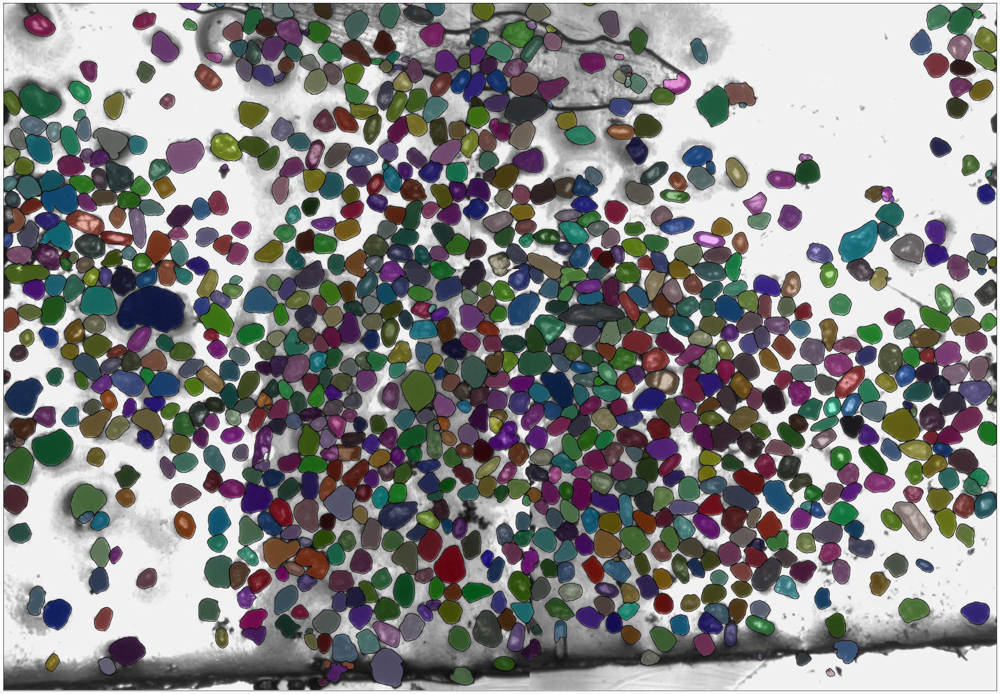

In [ ]:
# post-processing
from skimage.morphology import label
small_grain_threshold = 25 # objects that have an area smaller than this (in pixels) will be deleted
selem_size = 1 # increasing this parameter reduces the tendency to split grains. It is worth trying out 
                # a few values to see what works best for the image
dilate_size = 4
splitting = True # you can turn grain splitting on or off. Usually it is better to set this to 'True'
labels, grain_data, xs, ys = label_and_dilate_grains(big_im, big_im_pred, 
                                                small_grain_threshold, dilate_size, selem_size, splitting)

In [ ]:
grain_data[:10] # first ten lines of the data table

,label,area,centroid-0,centroid-1,major_axis_length,minor_axis_length,orientation,perimeter,max_intensity,mean_intensity,min_intensity
0,1,584,12.383562,67.570205,33.428904,22.696786,0.724825,95.012193,105.0,55.573630,40.0
1,2,681,6.807636,455.569750,50.393022,18.710947,1.528490,120.805087,193.0,59.556535,38.0
2,3,136,3.911765,507.117647,17.842272,10.018290,1.369830,45.798990,232.0,147.500000,96.0
3,4,234,4.696581,526.188034,24.438310,13.050016,-1.559640,64.284271,106.0,60.542735,45.0
4,5,423,5.657210,613.430260,39.489670,15.001278,1.462538,97.041631,164.0,78.697400,37.0
5,6,1563,19.069738,678.339091,52.629454,38.881751,1.139541,154.083261,90.0,36.769034,28.0
6,7,1364,17.835044,777.607038,49.133380,36.101221,0.835959,143.497475,93.0,43.074780,32.0
7,8,2352,29.747874,938.880952,63.855062,47.255293,-0.286636,185.095454,123.0,39.575680,22.0
8,9,130,2.815385,983.023077,21.419450,8.263420,1.541294,50.727922,215.0,100.492308,52.0
9,10,1205,13.639004,1050.923651,47.739784,33.775869,1.311429,136.911688,155.0,51.474689,35.0


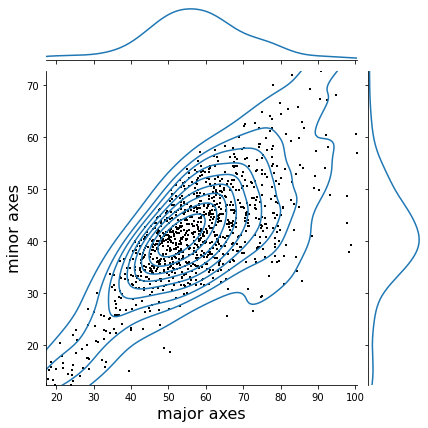

In [ ]:
import seaborn as sns
minx = np.percentile(grain_data['major_axis_length'], 1)
maxx = np.percentile(grain_data['major_axis_length'], 99)
miny = np.percentile(grain_data['minor_axis_length'], 1)
maxy = np.percentile(grain_data['minor_axis_length'], 99)

g = sns.jointplot(x="major_axis_length", y="minor_axis_length", data=grain_data, kind="kde", gridsize=300, xlim=[minx,maxx], ylim=[miny,maxy], marginal_kws=dict(gridsize=300))
g.plot_joint(plt.scatter, c="k", s=6, marker="+")
g.set_axis_labels("major axes", "minor axes", fontsize=16);

In [ ]:
regions = regionprops(labels)
len(regions)

998

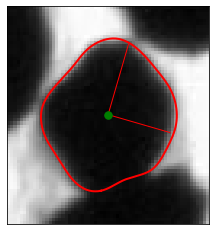

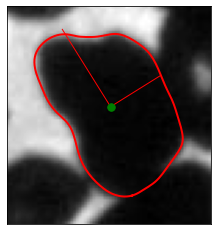

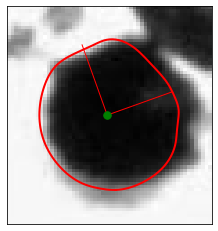

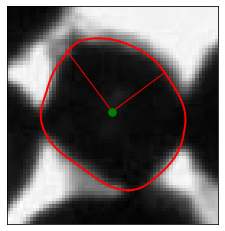

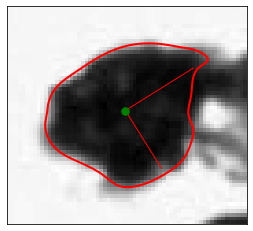

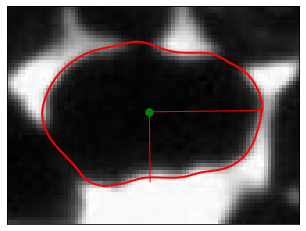

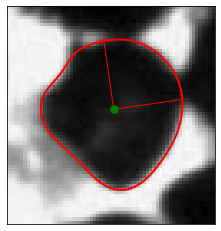

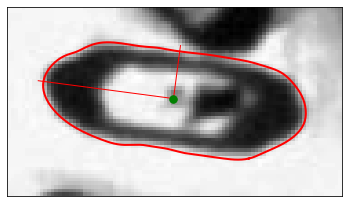

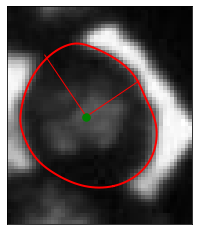

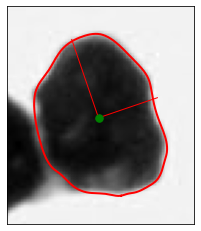

In [ ]:
for i in range(200, 210):
  curv, sx, sy = get_grain_curvature(big_im, labels, regions, i)

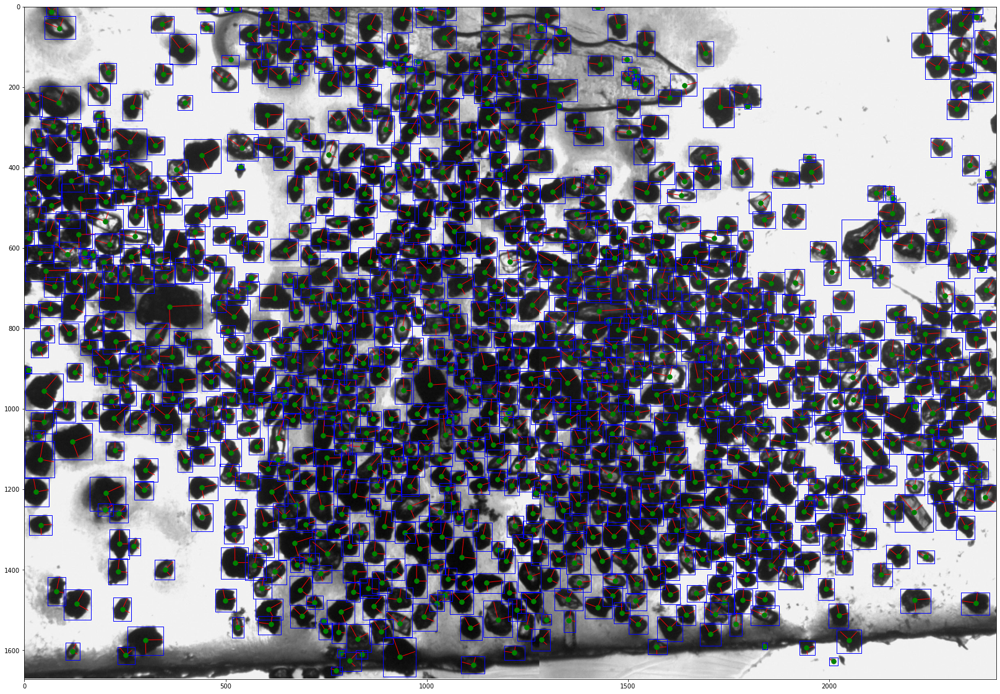

In [ ]:
# this next section is from: https://scikit-image.org/docs/stable/auto_examples/segmentation/plot_regionprops.html
regions = regionprops(labels)
fig = plt.figure(figsize=(30,20))
ax = fig.add_subplot(111)
ax.imshow(big_im, cmap='gray', interpolation=None)
for props in regions:
    y0, x0 = props.centroid
    orientation = props.orientation
    x1 = x0 + math.cos(orientation) * 0.5 * props.minor_axis_length
    y1 = y0 - math.sin(orientation) * 0.5 * props.minor_axis_length
    x2 = x0 - math.sin(orientation) * 0.5 * props.major_axis_length
    y2 = y0 - math.cos(orientation) * 0.5 * props.major_axis_length
    ax.plot((x0, x1), (y0, y1), '-r', linewidth=1)
    ax.plot((x0, x2), (y0, y2), '-r', linewidth=1)
    ax.plot(x0, y0, '.g', markersize=15)
    minr, minc, maxr, maxc = props.bbox
    bx = (minc, maxc, maxc, minc, minc)
    by = (minr, minr, maxr, maxr, minr)
    ax.plot(bx, by, '-b', linewidth=1)
ax.set_xlim(0, big_im.shape[1])
ax.set_ylim(big_im.shape[0], 0);

## Problem 2: Image segmentation to characterize sand samples

* Can we use the same approach to identfiy sand grains in photomicrographs of sand samples?
* After identifying the sand grains, can we sort them into a number of clusters?
* Feature extraction with a pretrained model <--
* Fine-tuning a pretrained model

In [ ]:
!wget https://www.dropbox.com/s/l35he6c86j8l01x/half_moon_bay_1_image.png
!wget https://www.dropbox.com/s/vka7bvufywavaq9/half_moon_bay_1_mask.png

--2023-03-26 21:56:30--  https://www.dropbox.com/s/l35he6c86j8l01x/half_moon_bay_1_image.png
Resolving www.dropbox.com (www.dropbox.com)... 162.125.81.18, 2620:100:6022:18::a27d:4212
Connecting to www.dropbox.com (www.dropbox.com)|162.125.81.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/l35he6c86j8l01x/half_moon_bay_1_image.png [following]
--2023-03-26 21:56:30--  https://www.dropbox.com/s/raw/l35he6c86j8l01x/half_moon_bay_1_image.png
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc9e58f8dddb73c5e64e600e9512.dl.dropboxusercontent.com/cd/0/inline/B5D2aredBcZIRqZsEi8ApDgYFgTnW5Wt30yWyXo2D86Y3t62MkTOSk4r7rGhBKAjwDHYadrs8qbdKySGZIlPjmZiu7TFtaH812QTU75M-Pu0JvUKNwFrGpOJZI4XctBtIXOmgUzCxtc6DgccISZtxGJdKTYgvGz0N5dqDBfGQAwkPg/file# [following]
--2023-03-26 21:56:31--  https://uc9e58f8dddb73c5e64e600e9512.dl.dropboxusercontent.com/cd/0/inline/B5D2aredBcZIRqZsEi8ApDgYFgTnW5Wt30yWyX

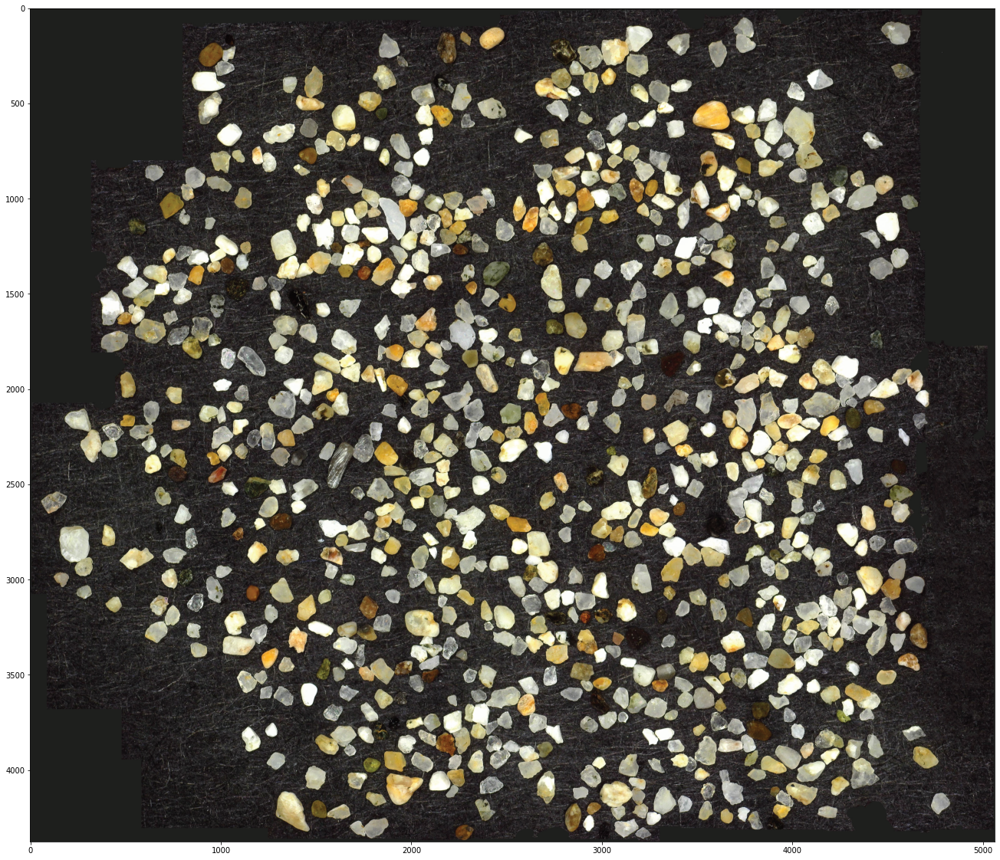

In [ ]:
im = plt.imread('half_moon_bay_1_image.png')
plt.figure(figsize=(30,20))
plt.imshow(im)

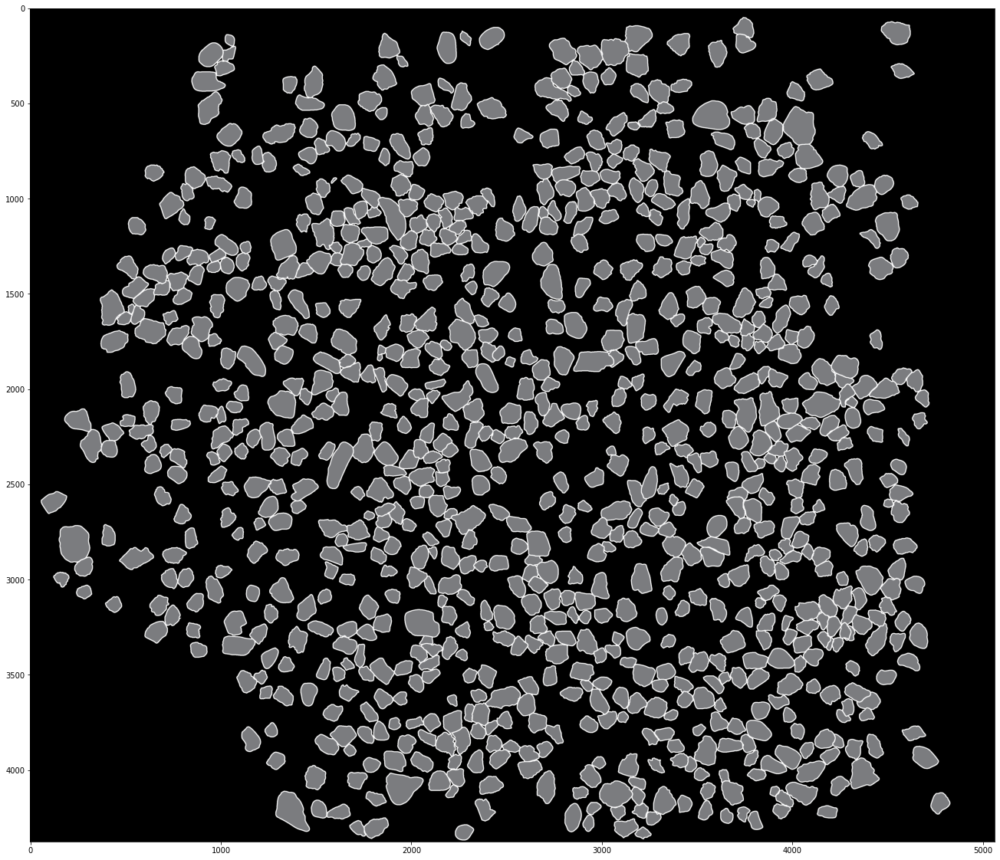

In [ ]:
im = plt.imread('half_moon_bay_1_mask.png')
plt.figure(figsize=(30,20))
plt.imshow(im)

In [ ]:
def weighted_crossentropy(y_true, y_pred):
    class_weights = tf.constant([[[[0.48, 1.36, 5]]]]) # increase the weight on the grains and the grain boundaries
    unweighted_losses = tf.nn.softmax_cross_entropy_with_logits(labels=y_true, logits=y_pred)
    weights = tf.reduce_sum(class_weights * y_true, axis=-1)
    weighted_losses = weights * unweighted_losses
    loss = tf.reduce_mean(weighted_losses)
    return loss

def Unet():
    tf.keras.backend.clear_session()

    image = tf.keras.Input((256, 256, 3),name='input')

    conv1 = Conv2D(16, (3,3), activation='relu', padding = 'same')(image)
    conv1 = Conv2D(16, (3,3), activation='relu', padding = 'same')(conv1)
    conv1 = BatchNormalization()(conv1)

    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv2 = Conv2D(32, (3,3), activation='relu', padding = 'same')(pool1)
    conv2 = Conv2D(32, (3,3), activation='relu', padding = 'same')(conv2)
    conv2 = BatchNormalization()(conv2)

    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(64, (3,3), activation='relu', padding = 'same')(pool2)
    conv3 = Conv2D(64, (3,3), activation='relu', padding = 'same')(conv3)
    conv3 = BatchNormalization()(conv3)

    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv4 = Conv2D(128, (3,3), activation='relu', padding = 'same')(pool3)
    conv4 = Conv2D(128, (3,3), activation='relu', padding = 'same')(conv4)
    conv4 = BatchNormalization()(conv4)

    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)
    conv5 = Conv2D(256, (3,3), activation='relu', padding = 'same')(pool4)
    conv5 = Conv2D(256, (3,3), activation='relu', padding = 'same')(conv5)
    conv5 = BatchNormalization()(conv5)

    up6 = Conv2DTranspose(128, (3, 3), strides = (2, 2), padding = 'same')(conv5)
    up6 = concatenate([up6, conv4])
    conv6 = Conv2D(128, (3,3), activation='relu', padding = 'same')(up6)
    conv6 = Conv2D(128, (3,3), activation='relu', padding = 'same')(conv6)
    conv6 = BatchNormalization()(conv6)

    up7 = Conv2DTranspose(64, (3, 3), strides = (2, 2), padding = 'same')(conv6)
    up7 = concatenate([up7, conv3])
    conv7 = Conv2D(64, (3,3), activation='relu', padding = 'same')(up7)
    conv7 = Conv2D(64, (3,3), activation='relu', padding = 'same')(conv7)
    conv7 = BatchNormalization()(conv7)

    up8 = Conv2DTranspose(32, (3, 3), strides = (2, 2), padding = 'same')(conv7)
    up8 = concatenate([up8, conv2])
    conv8 = Conv2D(32, (3,3), activation='relu', padding = 'same')(up8)
    conv8 = Conv2D(32, (3,3), activation='relu', padding = 'same')(conv8)
    conv8 = BatchNormalization()(conv8)

    up9 = Conv2DTranspose(16, (3, 3), strides = (2, 2), padding = 'same')(conv8)
    up9 = concatenate([up9, conv1])
    conv9 = Conv2D(16, (3,3), activation='relu', padding = 'same')(up9)
    conv9 = Conv2D(16, (3,3), activation='relu', padding = 'same')(conv9)
    conv9 = BatchNormalization()(conv9)

    conv10 = Conv2D(3, (1,1), activation='softmax')(conv9)
    model = Model(inputs=[image], outputs=[conv10])

    return model

In [ ]:
sand_model = Unet()
loss = weighted_crossentropy
sand_model.compile(optimizer=Adam(), loss=loss, metrics=["accuracy"])

In [ ]:
!wget https://www.dropbox.com/s/bc86p4u8cin8geh/model_1_sand_grains.h5

--2023-03-26 21:56:47--  https://www.dropbox.com/s/bc86p4u8cin8geh/model_1_sand_grains.h5
Resolving www.dropbox.com (www.dropbox.com)... 162.125.81.18, 2620:100:6031:18::a27d:5112
Connecting to www.dropbox.com (www.dropbox.com)|162.125.81.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/bc86p4u8cin8geh/model_1_sand_grains.h5 [following]
--2023-03-26 21:56:48--  https://www.dropbox.com/s/raw/bc86p4u8cin8geh/model_1_sand_grains.h5
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucba463f573e7c7b7bc342040db7.dl.dropboxusercontent.com/cd/0/inline/B5DQHNrkzWmppwe8CZ5reQxtc7gPTNhnoe34FEdsYxT7fNqiBku0QfXYHq-Nn4Ca54fQeSYgOGeBLFM3wq2ibFgZl6kLPOKJTWHfXz0x6N5Ae5mhRDBjcG0JHS6bXwRDvjPV8h1UtP57a-caFup9ssKlFq181SQk7FJ2Ew-XLVfuqQ/file# [following]
--2023-03-26 21:56:48--  https://ucba463f573e7c7b7bc342040db7.dl.dropboxusercontent.com/cd/0/inline/B5DQHNrkzWmppwe8CZ5reQxtc7gPTNhnoe34FEdsYxT7fNq

In [ ]:
sand_model.load_weights('model_1_sand_grains.h5') # load model weights from saved file

In [ ]:
!wget https://www.dropbox.com/s/i19gtrjm59brr9n/cape_disappointment_1.png

--2023-03-26 21:56:50--  https://www.dropbox.com/s/i19gtrjm59brr9n/cape_disappointment_1.png
Resolving www.dropbox.com (www.dropbox.com)... 162.125.81.18, 2620:100:6031:18::a27d:5112
Connecting to www.dropbox.com (www.dropbox.com)|162.125.81.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/i19gtrjm59brr9n/cape_disappointment_1.png [following]
--2023-03-26 21:56:51--  https://www.dropbox.com/s/raw/i19gtrjm59brr9n/cape_disappointment_1.png
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc4e9707bb033f4dfb229a9feb34.dl.dropboxusercontent.com/cd/0/inline/B5Cc3aqg9CVwecqXDlCJ0ZsXRnKFx3xI5kbD_ROy5GiCXm-5UmEc5OLXwPXtRLo7UDkkOv0RC-uStJUidZhIbfL8Vq-MuKliOeQpewMB70bQUBz15kQYeDjUN8WhGjdd1Bqj2lBzNp1-_1cBKLa6G7cYFFICL98T9_ZRBawDpTU4rg/file# [following]
--2023-03-26 21:56:51--  https://uc4e9707bb033f4dfb229a9feb34.dl.dropboxusercontent.com/cd/0/inline/B5Cc3aqg9CVwecqXDlCJ0ZsXRnKFx3xI5kbD_R

In [ ]:
big_im = load_img('cape_disappointment_1.png')
big_im = np.array(big_im)
big_im = big_im[1:, 1:, :]
big_im_pred = predict_big_image(big_im, sand_model, I=256)

# big_im = np.hstack((np.zeros((r*I, I2, 3)), big_im, np.zeros((r*I, I2, 3)))) # padding on the left and right sides

In [ ]:
np.shape(big_im)

  0%|          | 0/746 [00:00<?, ?it/s]<ipython-input-66-15e0c391e268>:91: FutureWarning: `selem` is a deprecated argument name for `binary_erosion`. It will be removed in version 1.0. Please use `footprint` instead.
  eroded = binary_erosion(eroded, selem = selem)
100%|██████████| 821/821 [00:00<00:00, 1238.00it/s]


plotting...


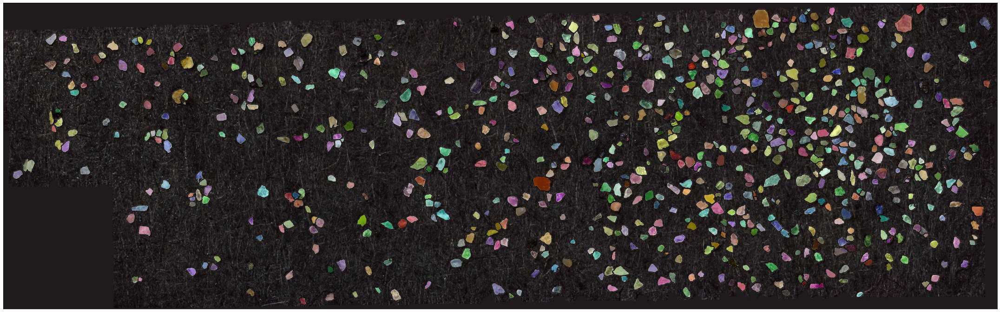

In [ ]:
# post-processing
from skimage.morphology import label
small_grain_threshold = 25 # objects that have an area smaller than this (in pixels) will be deleted
selem_size = 3 # increasing this parameter reduces the tendency to split grains. It is worth trying out 
                # a few values to see what works best for the image
dilate_size = 3
splitting = True # you can turn grain splitting on or off. Usually it is better to set this to 'True'
labels, grain_data, xs, ys = label_and_dilate_grains(big_im, big_im_pred, 
                                                small_grain_threshold, dilate_size, selem_size, splitting)

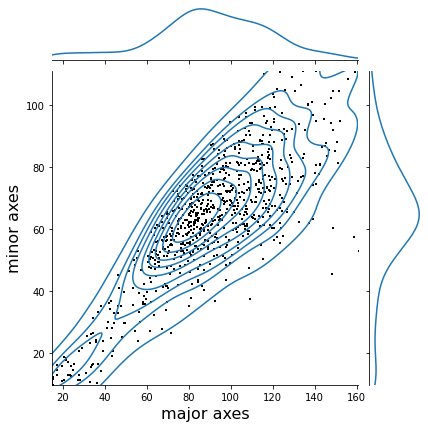

In [ ]:
import seaborn as sns
minx = np.percentile(grain_data['major_axis_length'], 1)
maxx = np.percentile(grain_data['major_axis_length'], 99)
miny = np.percentile(grain_data['minor_axis_length'], 1)
maxy = np.percentile(grain_data['minor_axis_length'], 99)

g = sns.jointplot(x="major_axis_length", y="minor_axis_length", data=grain_data, kind="kde", gridsize=300, xlim=[minx,maxx], ylim=[miny,maxy], marginal_kws=dict(gridsize=300))
g.plot_joint(plt.scatter, c="k", s=6, marker="+")
g.set_axis_labels("major axes", "minor axes", fontsize=16);

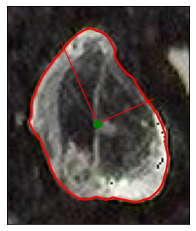

In [ ]:
regions = regionprops(labels)
curv, sx, sy = get_grain_curvature(big_im, labels, regions, 100)

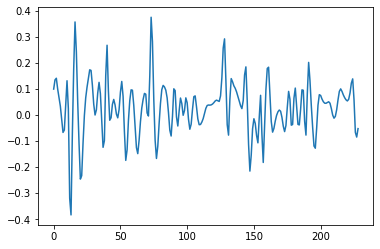

In [ ]:
# plot curvature
plt.plot(curv);

### Feature extraction and classification using pretrained model

We will use the VGG16 pretrained model (image classifier) to extract features from grain images and then apply k-means clustering to the features to obtain (hopefully) meaningful clusters of the grains.

<img src="https://raw.githubusercontent.com/zsylvester/GEO391_materials/master/swapping_classifiers.png" width="700">

[source: Francois Chollet, Deep Learning with Python, 2nd edition](https://github.com/fchollet/deep-learning-with-python-notebooks)


First we need to creat similar-sized images for all grains. Note the we are ignoring grain size in what follows and only focus on grain shape, color, and texture. We need to rotate the grains so that orientation does not matter in the clustering.

In [ ]:
# functions for creating grain images of same size, with grains oriented the same way

def squareify_image(im):
    if len(np.shape(im)) == 3:
        r, c, t = np.shape(im)
        if r > c:
            if np.mod(c-r, 2) == 0:
                im1 = np.concatenate((np.zeros((r, int((r-c)/2), t)).astype('uint8'), im, np.zeros((r, int((r-c)/2), t)).astype('uint8')), axis = 1)
            else:
                im1 = np.concatenate((np.zeros((r, int((r-c)/2)+1, t)).astype('uint8'), im, np.zeros((r, int((r-c)/2), t)).astype('uint8')), axis = 1)
        elif r < c:
            if np.mod(c-r, 2) == 0:
                im1 = np.concatenate((np.zeros((int((c-r)/2), c, t)).astype('uint8'), im, np.zeros((int((c-r)/2), c, t)).astype('uint8')), axis = 0)
            else:
                im1 = np.concatenate((np.zeros((int((c-r)/2)+1, c, t)).astype('uint8'), im, np.zeros((int((c-r)/2), c, t)).astype('uint8')), axis = 0)
        else:
            im1 = im
    if len(np.shape(im)) == 2:
        r, c = np.shape(im)
        if r > c:
            if np.mod(c-r, 2) == 0:
                im1 = np.concatenate((np.zeros((r, int((r-c)/2))).astype('uint8'), im, np.zeros((r, int((r-c)/2))).astype('uint8')), axis = 1)
            else:
                im1 = np.concatenate((np.zeros((r, int((r-c)/2)+1)).astype('uint8'), im, np.zeros((r, int((r-c)/2))).astype('uint8')), axis = 1)
        elif r < c:
            if np.mod(c-r, 2) == 0:
                im1 = np.concatenate((np.zeros((int((c-r)/2), c)).astype('uint8'), im, np.zeros((int((c-r)/2), c)).astype('uint8')), axis = 0)
            else:
                im1 = np.concatenate((np.zeros((int((c-r)/2)+1, c)).astype('uint8'), im, np.zeros((int((c-r)/2), c)).astype('uint8')), axis = 0)
        else:
            im1 = im
    return im1

def create_grain_image(labels, big_im, big_im_pred, regions, ind, pad):
    filled = labels.copy()
    filled[filled>0] = 1
    minrow, mincol, maxrow, maxcol = regions[ind].bbox
    label_im = filled[max(0,minrow - pad):maxrow + pad, 
                      max(0,mincol - pad):maxcol + pad].copy()
    label_im[labels[max(0,minrow - pad):maxrow + pad, 
                    max(0,mincol - pad):maxcol + pad] != regions[ind]["label"]] = 0
    if maxcol >= filled.shape[1]:
        im = np.hstack((label_im, np.zeros((label_im.shape[0],2))))
    im = big_im[max(0,minrow - pad):maxrow + pad, max(0,mincol - pad):maxcol + pad].copy()
    im[label_im == 0] = 0
    im = squareify_image(im)
    im = np.array(Image.fromarray(im).rotate(-np.rad2deg(regions[ind].orientation)))
    pred_im = big_im_pred[max(0,minrow - pad):maxrow + pad, max(0,mincol - pad):maxcol + pad, 2].copy()
    pred_im[labels[max(0,minrow - pad):maxrow + pad, max(0,mincol - pad):maxcol + pad] != regions[ind]["label"]] = 0
    pred_im = squareify_image(pred_im)
    pred_im = np.array(Image.fromarray(pred_im).rotate(-np.rad2deg(regions[ind].orientation)))
    pred_im = np.expand_dims(pred_im, axis=2)
    label_im = squareify_image(label_im)
    label_im = Image.fromarray((label_im * 255).astype(np.uint8)).rotate(-np.rad2deg(regions[ind].orientation))
    label_im = (np.array(label_im)/255).astype('float')
    label_im = np.expand_dims(label_im, axis=2)
    original_size = im.shape[0]
    im = tf.image.resize(im, (224, 224), antialias=False)
    im = np.array(im).astype('uint8')
    label_im = tf.image.resize(label_im, (224, 224), antialias=True)
    label_im = np.array(label_im).astype('uint8')
    pred_im = tf.image.resize(pred_im, (224, 224), antialias=False)
    return im, label_im, pred_im, original_size

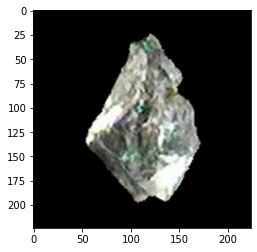

In [ ]:
im, label_im, pred_im, original_size = create_grain_image(labels, big_im, big_im_pred, regions, 500, pad=20)
plt.imshow(im);

In [ ]:
original_sizes = []
valid_grain_inds = []
pad = 20

for i in trange(len(regions)):
    im, label_im, pred_im, original_size = create_grain_image(labels, big_im, big_im_pred, regions, i, pad)
    # trying to get rid of grain clusters with this:
    dist = ndi.distance_transform_edt(pred_im)
    wshed = watershed(dist)
    if (np.max(wshed) == 1) & (original_size>120): 
        if i == 0:
            all_images = np.expand_dims(im, 0)
            all_labels = np.expand_dims(label_im, 0)
            original_sizes.append(original_size)
            valid_grain_inds.append(i)
        else:
            all_images = np.concatenate((all_images, np.expand_dims(im, 0)), axis=0)
            all_labels = np.concatenate((all_labels, np.expand_dims(label_im, 0)), axis=0)
            original_sizes.append(original_size)
            valid_grain_inds.append(i)
original_sizes = np.array(original_sizes)

In [ ]:
np.shape(all_images)

### Use VGG16 model to extract features

In [ ]:
from keras.applications.vgg16 import VGG16 
# load model
model_VGG16 = VGG16()
# remove the output layer
model_VGG16_modified = Model(inputs=model_VGG16.inputs, outputs=model_VGG16.layers[-2].output)

In [ ]:
model_VGG16.summary()

In [ ]:
model_VGG16_modified.summary()

In [ ]:
features = model_VGG16_modified.predict(np.expand_dims(im, 0))

In [ ]:
np.shape(features)

In [ ]:
plt.plot(features[0]);

In [ ]:
# extract all features
for i in trange(np.shape(all_images)[0]):
    features = model_VGG16_modified.predict(np.expand_dims(all_images[i], 0), verbose = 0)
    if i == 0:
        all_features = features
    else:
        all_features = np.concatenate((all_features, features), axis=0)

### Apply PCA and K-means clustering to features

In [ ]:
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

pca = PCA(n_components=25, random_state=22)
pca.fit(all_features)
x = pca.transform(all_features)

n_clusters = 10 # number of clusters
kmeans = KMeans(n_clusters=n_clusters, random_state=22)
kmeans.fit(x);

In [ ]:
plt.plot(x[10, :]); # principal components for 10th grain

In [ ]:
def create_grain_panel_cluster(cluster_number, labels):
    cluster = np.where(labels == cluster_number)[0]
    n_rows = n_cols = int(np.floor(len(cluster)**0.5))
    rand_inds = np.random.choice(cluster, size = n_cols*n_rows, replace = False)
    cl_panel = np.zeros((224*n_rows, 224*n_cols, 3))
    grain_inds = np.zeros((n_rows, n_cols))
    for i in range(n_rows):
        for j in range(n_cols):
            cl_panel[i*224:(i+1)*224, j*224:(j+1)*224, :] = all_images[rand_inds[i*n_cols + j]]
            grain_inds[i, j] = int(rand_inds[i*n_cols + j])     
    return cl_panel, grain_inds

def create_grain_panel(inds, n_rows, n_cols):
    cl_panel = np.zeros((224*n_rows, 224*n_cols, 3))
    for i in range(n_rows):
        for j in range(n_cols):
            cl_panel[i*224:(i+1)*224, j*224:(j+1)*224, :] = all_images[inds[i*n_cols + j]]
    return cl_panel

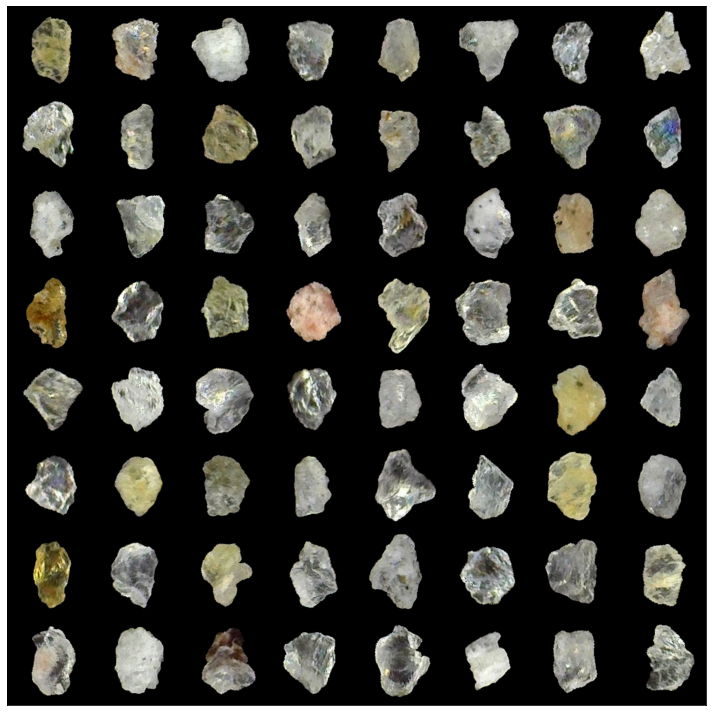

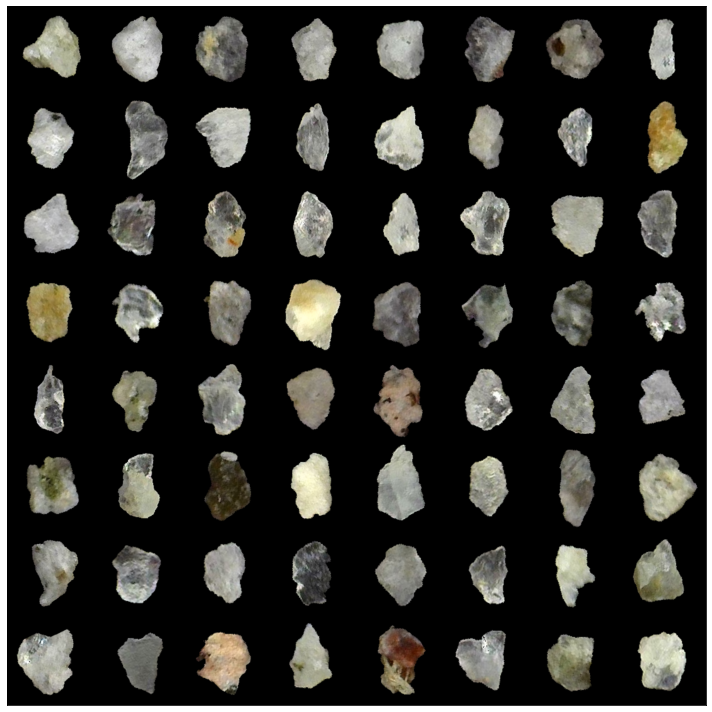

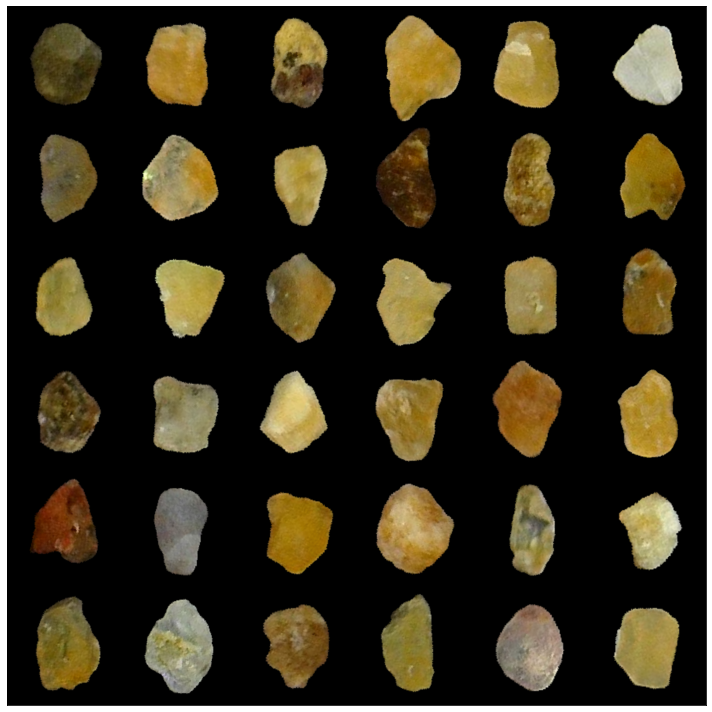

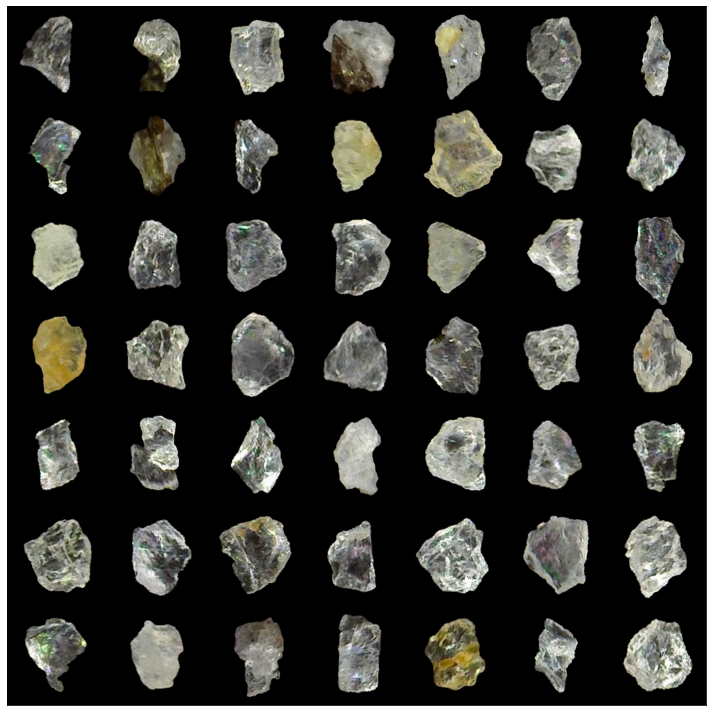

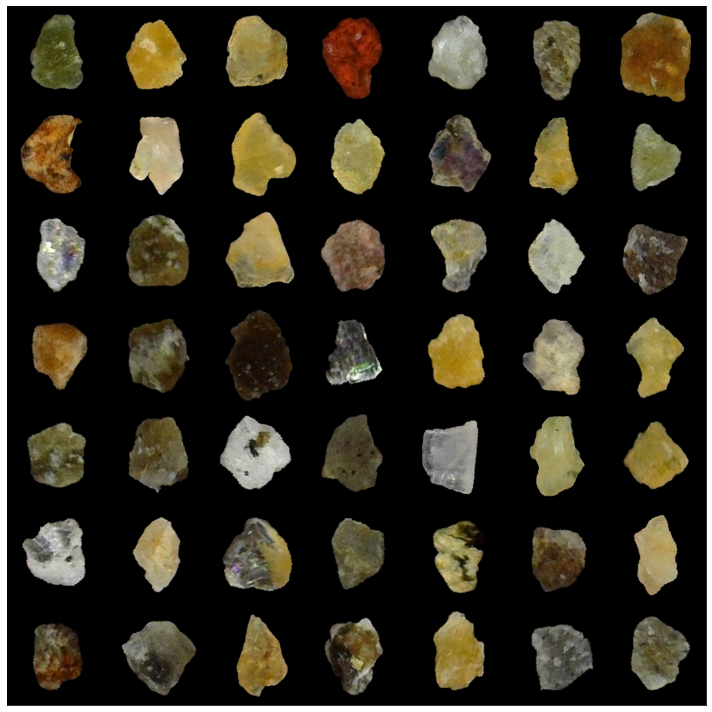

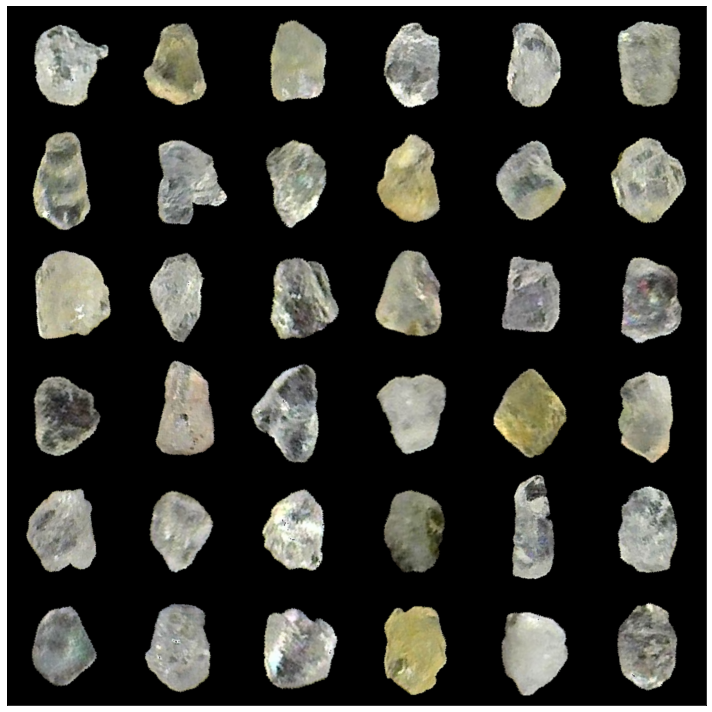

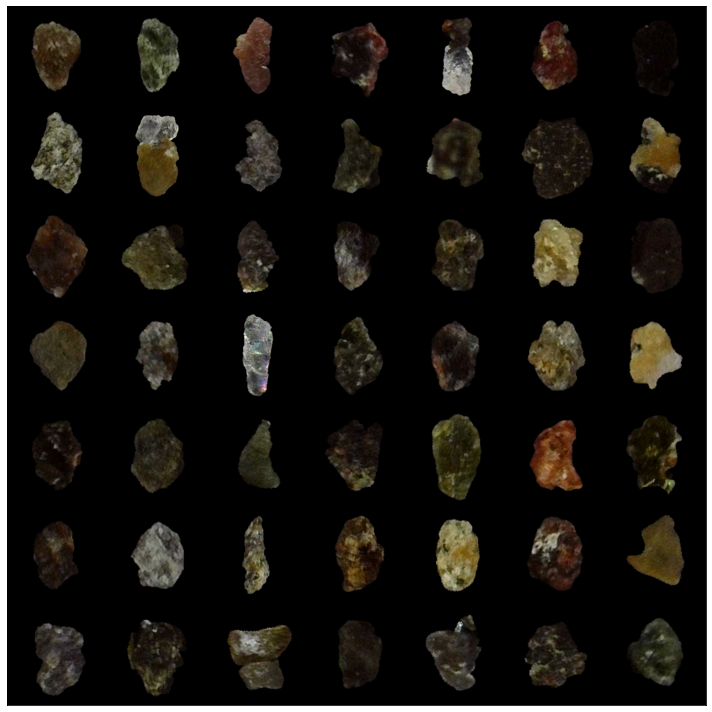

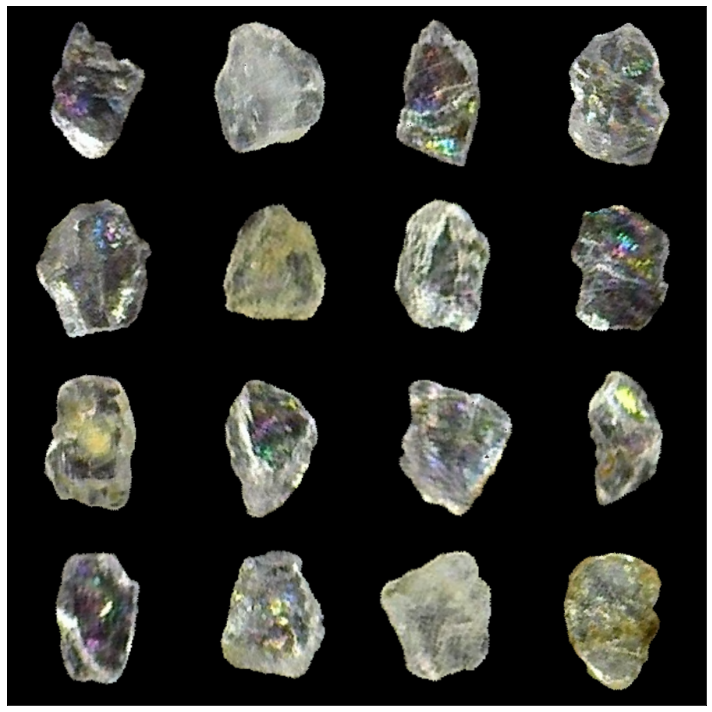

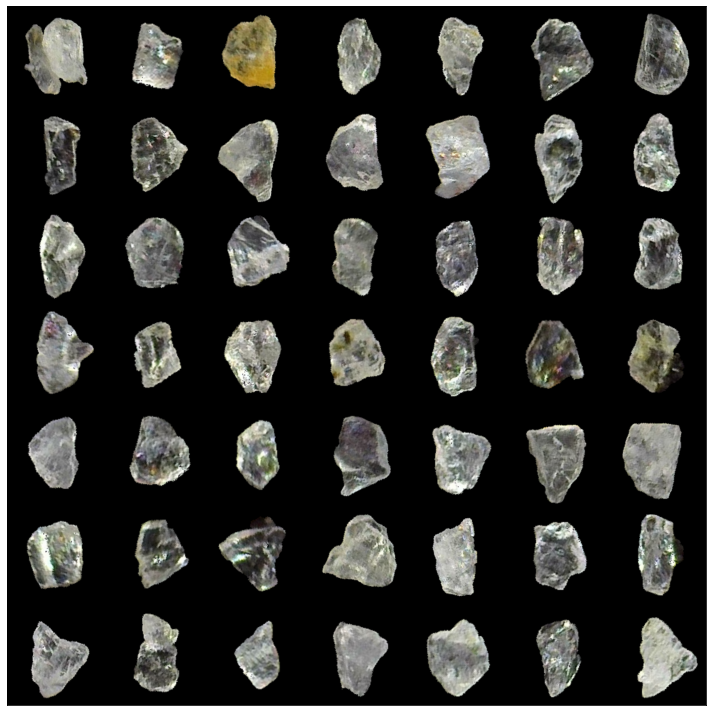

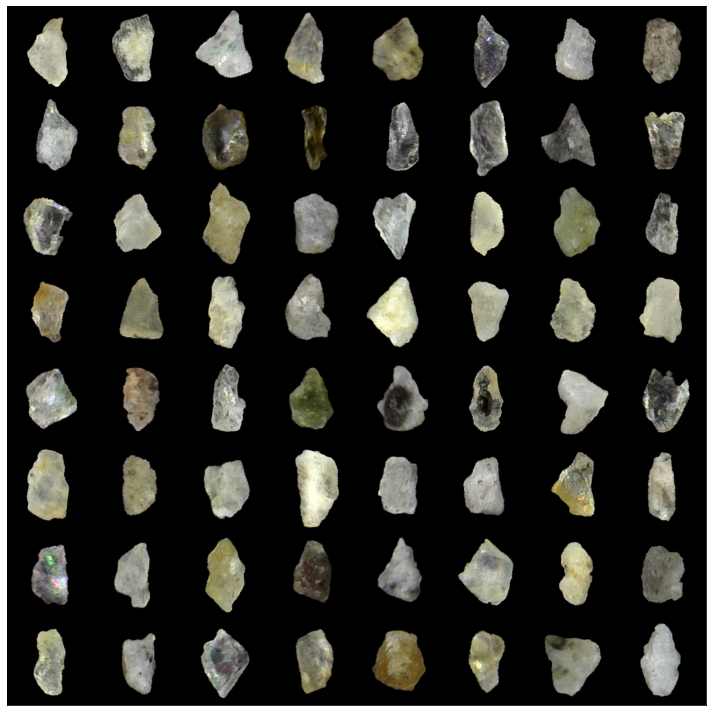

In [ ]:
for ind in range(10):
    cl_panel, grain_inds = create_grain_panel_cluster(ind, kmeans.labels_)
    fig = plt.figure(figsize=(10,10))
    plt.imshow(cl_panel.astype('uint8'))
    plt.xticks([])
    plt.yticks([])
    plt.tight_layout()

## Problem 3: Image segmentation to map permafrost polygons

* Can we use the same Unet-based approach to map permafrost polygons associated with meander growth in Arctic rivers?

In [ ]:
!wget https://www.dropbox.com/s/n85y3q9nif9wbfi/test_image_2.tif

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(big_im);

### Create training images from satellite images and GIS interpretations

In [ ]:
!wget https://www.dropbox.com/s/zkr1z5bn00brvky/meander_3_polygons_3857.zip

In [ ]:
!unzip meander_3_polygons_3857.zip

In [ ]:
!wget https://www.dropbox.com/s/k24yezshxls4in8/meander_3_image.tif

In [ ]:
!pip install rasterio

In [ ]:
!pip install geopandas

In [ ]:
import rasterio
import geopandas as gpd
import pandas as pd
from rasterio import features

shp_fn = 'meander_3_polygons_EPSG_3857.shp'
rst_fn = 'meander_3_image.tif'
rst = rasterio.open(rst_fn)
lines = []
polys = gpd.read_file(shp_fn)
for poly in polys['geometry']:
    lines.append(poly.boundary.buffer(3))    
values = 255*np.ones((len(polys),))
src = rasterio.open(rst_fn)
rst_arr = 0*src.read(1)
shapes = ((geom, value) for geom, value in zip(lines, values))
boundaries = features.rasterize(shapes=shapes, fill=0, out=rst_arr, transform=src.transform)
plt.figure(figsize = (20,20))
plt.imshow(boundaries);

In [ ]:
poly_geoms = []
for poly in polys['geometry']:
    poly_geoms.append(poly)    
values = 255*np.ones((len(polys),))
src = rasterio.open(rst_fn)
rst_arr = 0*src.read(1)
shapes = ((geom, value) for geom, value in zip(poly_geoms, values))
polygons = features.rasterize(shapes=shapes, fill=0, out=rst_arr, transform=src.transform)
plt.figure(figsize=(20, 20))
plt.imshow(polygons);

In [ ]:
mask = np.zeros(np.shape(boundaries))
mask[boundaries == 255] = 125
mask[(polygons == 255) & (boundaries != 255)] = 255
plt.figure(figsize = (20, 20))
plt.imshow(mask)

### Create model and read weights

In [ ]:
polygon_model = Unet()
loss = weighted_crossentropy
polygon_model.compile(optimizer=Adam(), loss=loss, metrics=["accuracy"])

In [ ]:
!wget https://www.dropbox.com/s/8nmdgy7k29t4rq2/polygon_model_3.h5

In [ ]:
polygon_model.load_weights('polygon_model_3.h5')

### Make predictions

In [ ]:
big_im = np.array(load_img('test_image_2.tif'))
big_im_pred = predict_big_image(big_im, polygon_model, I=256)

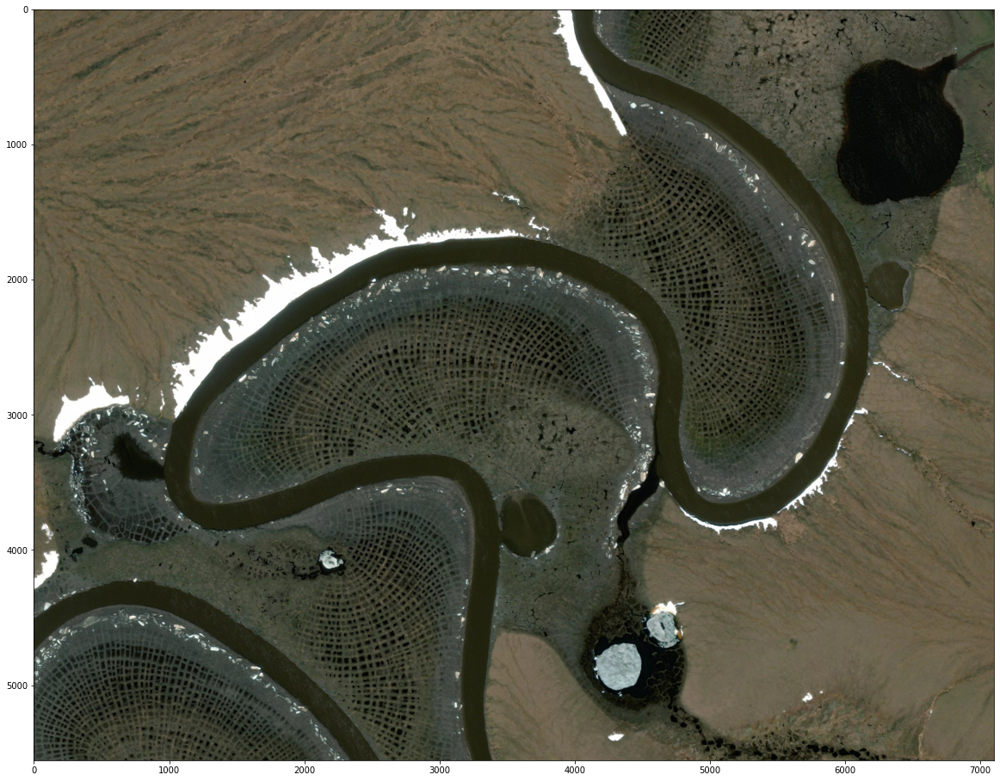

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(big_im);

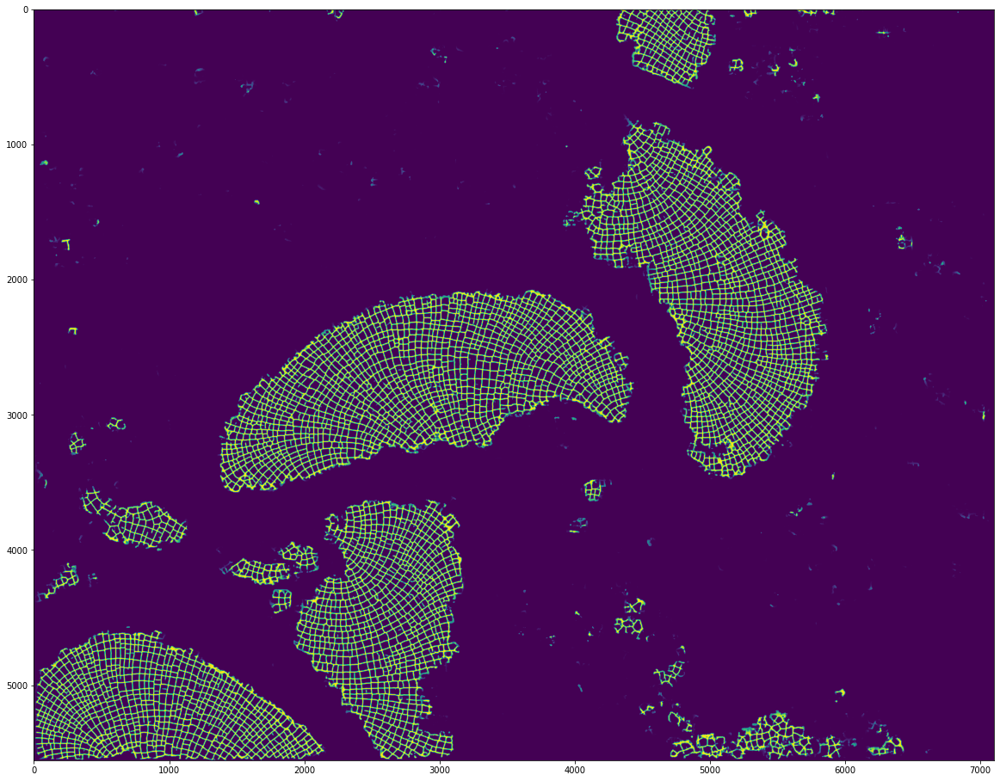

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(big_im_pred[:,:,1]);

### Create polygons and save them to shapefiles

In [ ]:
polys = big_im_pred[:, :, 2].copy()
boundaries = big_im_pred[:, :, 1].copy()
polys[polys>0.5] = 1
boundaries[boundaries>0.5] = 1
polys[boundaries == 1] = 0

labels, n_labels = label(polys, background=0, return_num=True) # object labeling
small_grain_threshold = 100
object_features = regionprops(labels)
object_areas = [objf["area"] for objf in object_features]
# find the indices of small objects:
small_obj_inds = np.where(np.array(object_areas)<small_grain_threshold)[0]+1
count = 0
for ind in tqdm(small_obj_inds):  # this can take a long time for a large image!
    labels[labels == ind] = 0
    count += 1
# fill holes:
labels[labels>0] = 1
seed = np.copy(labels)
seed[1:-1, 1:-1] = labels.max()
filled = reconstruction(seed, labels, method='erosion')
labels, n_labels = label(filled, return_num = True) # re-label image

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(labels);

In [ ]:
import scipy.interpolate
import math
from skimage.measure import regionprops
from skimage import measure
from shapely.geometry import Polygon, LinearRing, LineString, Point

def compute_s_coordinates(x, y):
    dx = np.gradient(x) # first derivatives
    dy = np.gradient(y)   
    ds = np.sqrt(dx**2+dy**2)
    s = np.hstack((0,np.cumsum(ds[1:])))
    return s

def get_poly_outline(labels, regions, ind):
    filled = labels.copy()
    filled[filled>0] = 1
    minrow, mincol, maxrow, maxcol = regions[ind].bbox
    im = filled[max(0,minrow-2):maxrow+2,max(0,mincol-2):maxcol+2].copy()
    im[labels[max(0,minrow-2):maxrow+2,max(0,mincol-2):maxcol+2] != regions[ind]["label"]] = 0
    if maxcol >= filled.shape[1]:
        im = np.hstack((im, np.zeros((im.shape[0],2))))
    contours = measure.find_contours(im, 0.5)
    x = contours[0][:,1] + mincol - 2 + 0.5
    y = contours[0][:,0] + minrow - 2 + 0.5
    if len(x) > 5:
      s = compute_s_coordinates(x, y)
      deltas = 1.0
      tck, u = scipy.interpolate.splprep([x,y], s=10, per=True) 
      unew = np.linspace(0,1,1+int(np.round(s[-1]/deltas))) # vector for resampling
      out = scipy.interpolate.splev(unew,tck) # resampling
      sx, sy = out[0], out[1]
    else:
      sx = sy = []
    return sx, sy

def create_poly(sx, sy):
    coords = []
    for i in range(len(sx)):
        coords.append((sx[i],sy[i]))
    poly = Polygon(LinearRing(coords))
    if not poly.is_valid:
        poly = poly.buffer(0)
    return poly

In [ ]:
regions = regionprops(labels)
sx, sy = get_poly_outline(labels, regions, 1010)
poly = create_poly(sx, sy)
poly

In [ ]:
sx, sy = get_poly_outline(labels, regions, 1020)
poly = create_poly(sx, sy)
poly

In [ ]:
rst = rasterio.open('test_image_2.tif')
left_utm_x = rst.bounds[0] 
right_utm_x = rst.bounds[2]
lower_utm_y = rst.bounds[1]
upper_utm_y = rst.bounds[3]
delta_x = rst.get_transform()[1]
delta_y = rst.get_transform()[5]

all_polys = []
areas = []

for i in trange(500):
    sx, sy = get_poly_outline(labels, regions, i)
    if len(sx) > 0:
      sxm = left_utm_x + 0.5*delta_x + sx*delta_x 
      sym = upper_utm_y + 0.5*delta_y + sy*delta_y 
      poly = create_poly(sxm, sym)
      all_polys.append(poly)
      areas.append(poly.area)

In [ ]:
polydata = {'area': areas}
df = pd.DataFrame(polydata)
gdf = gpd.GeoDataFrame(df, geometry=all_polys)
gdf.crs = 'epsg:3857'
gdf.to_file('all_polys.shp')

In [ ]:
ls

## Task 1

Load the 'meander_4.tif' image (use the link below to download it) and run the permafrost polygon model to detect polygons. Compute the mean area and length of the polygons (in pixels); you can use a subset of all the polygons to do this (so that you do not have to go through all the ~3000 or so polygons).

In [ ]:
!wget https://www.dropbox.com/s/ogrf7x57gqs96fh/meander_4.tif

In [ ]:
big_im_task1 = np.array(load_img('meander_4.tif'))

In [ ]:
big_im_pred_task1 = predict_big_image(big_im_task1, polygon_model, I=256)

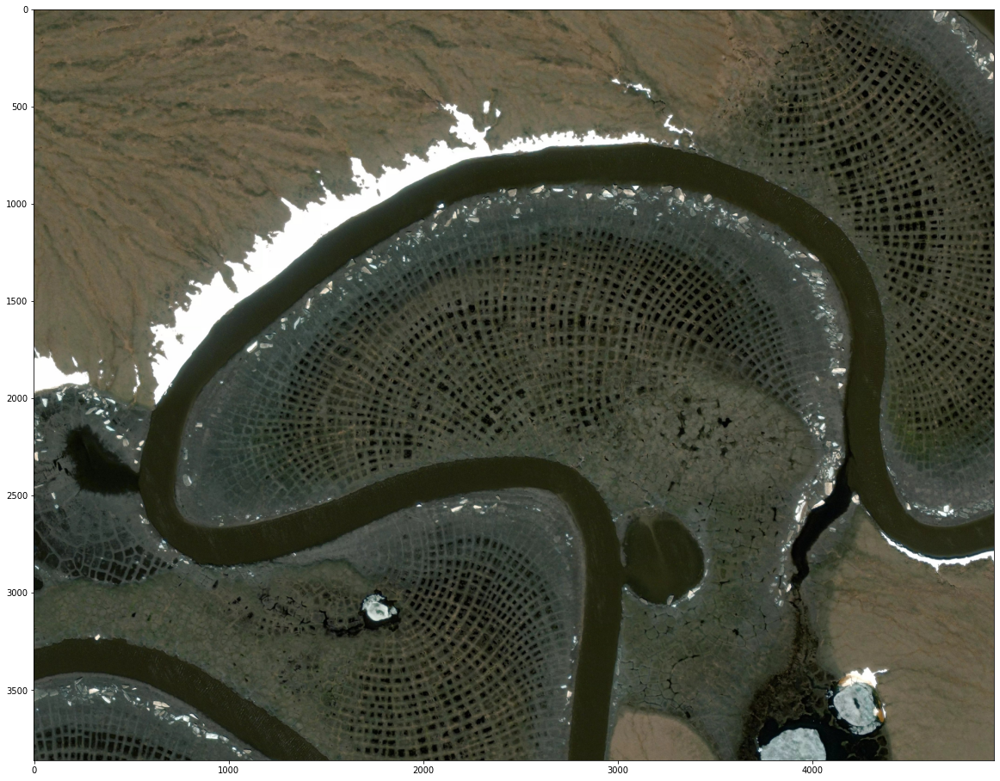

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(big_im_task1);

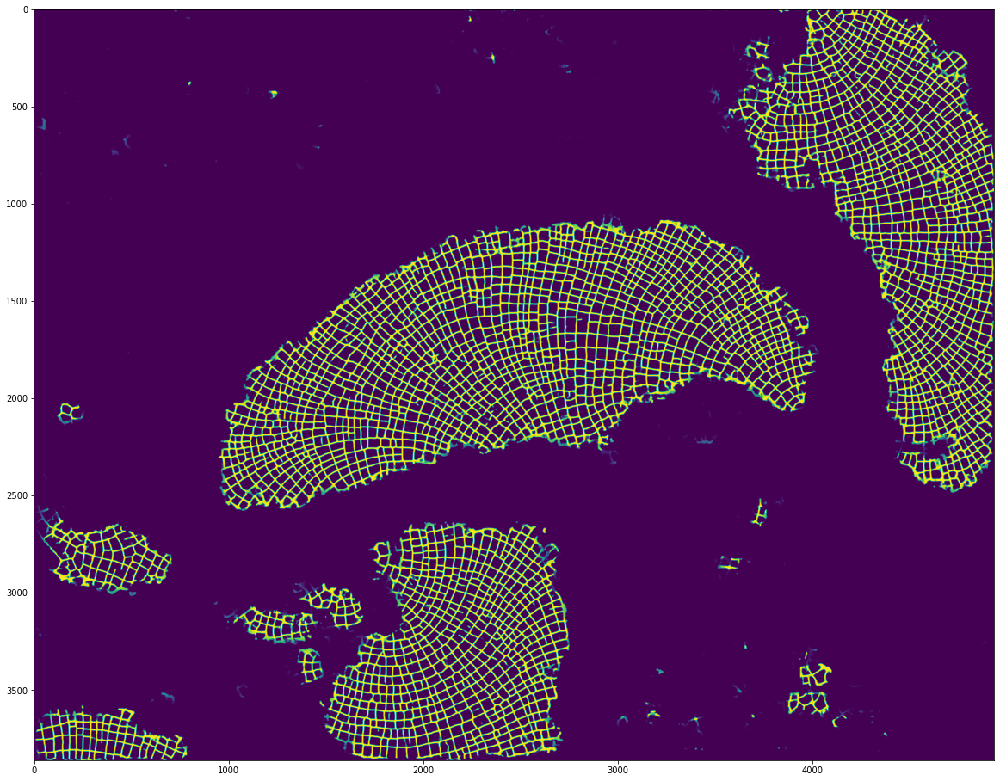

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(big_im_pred_task1[:,:,1]);

In [ ]:
polys = big_im_pred_task1[:, :, 2].copy()
boundaries = big_im_pred_task1[:, :, 1].copy()
polys[polys>0.5] = 1
boundaries[boundaries>0.5] = 1
polys[boundaries == 1] = 0

labels, n_labels = label(polys, background=0, return_num=True) # object labeling
small_grain_threshold = 100
object_features = regionprops(labels)
object_areas = [objf["area"] for objf in object_features]
# find the indices of small objects:
small_obj_inds = np.where(np.array(object_areas)<small_grain_threshold)[0]+1
count = 0
for ind in tqdm(small_obj_inds):  # this can take a long time for a large image!
    labels[labels == ind] = 0
    count += 1
# fill holes:
labels[labels>0] = 1
seed = np.copy(labels)
seed[1:-1, 1:-1] = labels.max()
filled = reconstruction(seed, labels, method='erosion')
labels, n_labels = label(filled, return_num = True) # re-label image

In [ ]:
plt.figure(figsize=(20,20))
plt.imshow(labels);

In [ ]:
regions = regionprops(labels)
sx, sy = get_poly_outline(labels, regions, 1010)
poly = create_poly(sx, sy)
poly

In [ ]:
regions = regionprops(labels)
sx, sy = get_poly_outline(labels, regions, 10)
poly = create_poly(sx, sy)
poly

In [ ]:
poly.area

In [ ]:
poly.length

In [ ]:
sum_poly_area = 0
sum_poly_length = 0

for i in trange(500):
  sx, sy = get_poly_outline(labels, regions, i)
  poly = create_poly(sx, sy)
  sum_poly_area = sum_poly_area+poly.area
  sum_poly_length = sum_poly_length+poly.length

mean_poly_area = sum_poly_area/500.
mean_poly_length = sum_poly_length/500.

In [ ]:
print(mean_poly_area)
print(mean_poly_length)

## Task 2

Try to improve the accuracy of the zircon grain detection model from the ~92% that we have seen so far, by adding more training data through additional image augmentation techniques. Make sure you do not use techniques that would create 'unrealistic' patches - e.g., grain boundaries not terminating at the edge of the patch. If you get a model with higher accuracy but more overfitting, which is the better model to use?

### We increases the number of images from 39600 to 83600, adding the gamma features, the accuracy and loss becomes better.

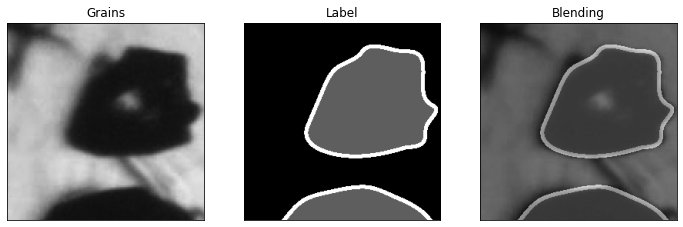

In [ ]:
gamma = createTechnique("gamma",{"gamma":0.5})
augmentor.addTransformer(transformer(gamma))
gammaGenerator = transformer(gamma)
gammaImg, gammaLabel = gammaGenerator.transform(img,mask)
plot_images_and_labels(gammaImg, gammaLabel)

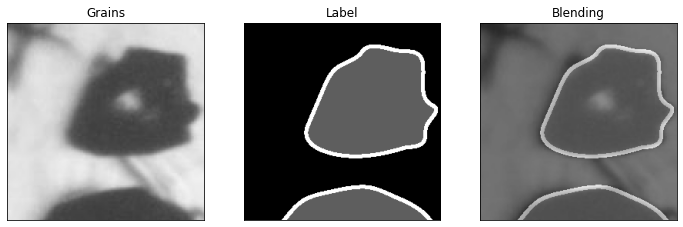

In [ ]:
gamma = createTechnique("gamma",{"gamma":1.0})
augmentor.addTransformer(transformer(gamma))
gammaGenerator = transformer(gamma)
gammaImg, gammaLabel = gammaGenerator.transform(img,mask)
plot_images_and_labels(gammaImg, gammaLabel)

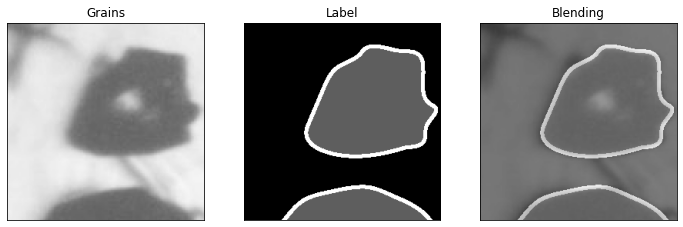

In [ ]:
gamma = createTechnique("gamma",{"gamma":1.5})
augmentor.addTransformer(transformer(gamma))
gammaGenerator = transformer(gamma)
gammaImg, gammaLabel = gammaGenerator.transform(img,mask)
plot_images_and_labels(gammaImg, gammaLabel)

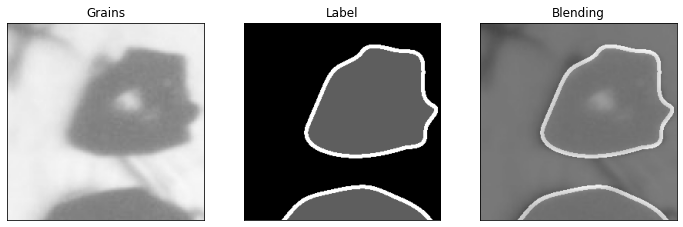

In [ ]:
gamma1 = createTechnique("gamma",{"gamma":2.0})
augmentor.addTransformer(transformer(gamma1))
gammaGenerator = transformer(gamma1)
gammaImg,gammaLabel = gammaGenerator.transform(img,mask)
plot_images_and_labels(gammaImg, gammaLabel)

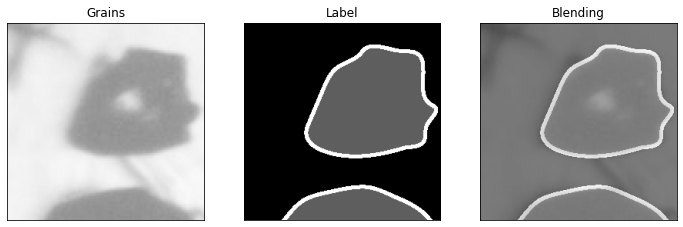

In [ ]:
gamma2 = createTechnique("gamma",{"gamma":2.5})
augmentor.addTransformer(transformer(gamma2))
gammaGenerator = transformer(gamma2)
gammaImg,gammaLabel = gammaGenerator.transform(img,mask)
plot_images_and_labels(gammaImg, gammaLabel)

In [ ]:
none = createTechnique("none",{}) # need to copy the original images as well!
augmentor.addTransformer(transformer(none))

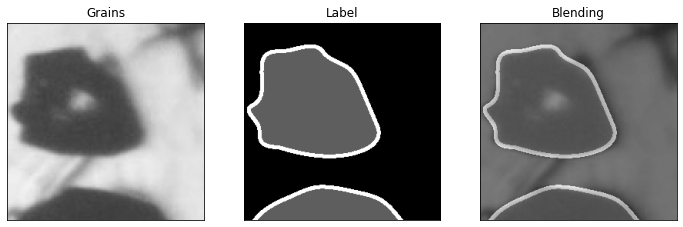

In [ ]:
fliph = createTechnique("flip",{"flip":1})
flipv = createTechnique("flip",{"flip":0})
augmentor.addTransformer(transformer(fliph))
augmentor.addTransformer(transformer(flipv))
flipGenerator = transformer(fliph)
flipImg, flipLabel = flipGenerator.transform(img,mask)
plot_images_and_labels(flipImg, flipLabel)

In [ ]:
len(augmentor.transformers) # we have created 9 transformers: 3 rotations, 3 gamma transformations, 2 flips, and the original images

27

In [ ]:
augmentor.applyAugmentation() # apply the augmentation; this takes a while

In [ ]:
from glob import glob 
images = sorted(glob("/content/augmented_images/images/*.png"))
labels = sorted(glob("/content/augmented_images/labels/*.png")) 

In [ ]:
len(images)

83600

In [ ]:
# split half into training
train_idx = np.random.choice(np.arange(len(images)), size = int(len(images)/2) , replace=False)
# get the rest
idx = np.setdiff1d(np.arange(len(images)), train_idx)
# get val files (25% of total)
val_idx = np.random.choice(idx, size = int(len(images)/4) , replace=False)
# get test files (25% of total)
test_idx = np.setdiff1d(val_idx, train_idx)

In [ ]:
def image_batch_generator(files, im_size, batch_size = 8):
  
  while True: # this is here because it will be called repeatedly by the training function
    
    # extract a random subset of files of length "batch_size"
    batch = np.random.choice(files, size = batch_size)    
    
    # variables for collecting batches of inputs (x) and outputs (y)
    batch_x = []
    batch_y = []
    
    #cycle through each image in the batch
    for f in batch:
        # open the image and resize
        image = np.array(Image.open(f))
        image = image[:,:,0]/255.0 # scale input image to (0, 1)
        image = np.expand_dims(image,2)
        batch_x.append(image) 

        # open label image by string substitution
        mask = np.array(Image.open(f.replace('/images/','/labels/')))
        mask = mask[:,:,0]
        temp = np.zeros((im_size, im_size, 3)) # create expanded target with channels for 3 classes
        temp[:,:,0][mask==0] = 1 # background
        temp[:,:,1][mask==94] = 1 # grain
        temp[:,:,2][mask==255] = 1 # boundary
        mask = temp
        batch_y.append(mask)

    # turn into numpy arrays
    batch_x = np.array(batch_x) 
    batch_y = np.array(batch_y)

    yield (batch_x, batch_y) #yield both the image and the label together

In [ ]:
gen = image_batch_generator(images, im_size = 256, batch_size = 8)

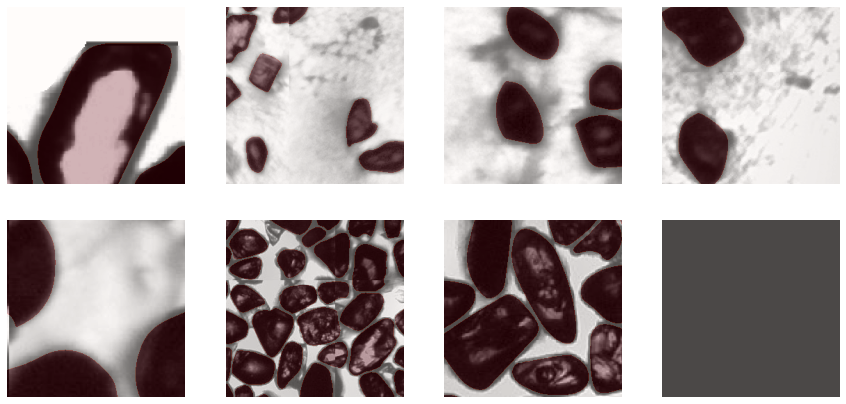

In [ ]:
x1, y1 = next(gen)

plt.figure(figsize=(15,15))

counter = 0
for k in range(8):
  plt.subplot(4,4,counter+1)
  plt.imshow(x1[counter][:,:,0],  cmap=plt.cm.gray)
  plt.imshow(y1[counter][:,:,1], alpha=0.3, cmap=plt.cm.Reds)
  plt.axis('off')
  counter += 1

In [ ]:
np.shape(x1[0]) # image

(256, 256, 1)

In [ ]:
np.shape(y1[0]) # label

(256, 256, 3)

In [ ]:
# create arrays of training, validation, and test files (these are filenames)
train_files = np.array(images)[train_idx]
val_files = np.array(images)[val_idx]
test_files = np.array(images)[test_idx]

In [ ]:
train_files[:5]

array(['/content/augmented_images/images/3117_20_im4179.png',
       '/content/augmented_images/images/3505_14_im1644.png',
       '/content/augmented_images/images/4112_16_im968.png',
       '/content/augmented_images/images/4236_23_im1616.png',
       '/content/augmented_images/images/2472_17_im240.png'], dtype='<U51')

In [ ]:
im_size = 256
batch_size = 64
train_generator = image_batch_generator(train_files, im_size, batch_size = batch_size) # call the batch generator for train set
val_generator  = image_batch_generator(val_files, im_size, batch_size = batch_size) # call batch generator validation set
train_steps = len(train_files)//batch_size # number of steps per training epoch
val_steps = len(val_files)//batch_size # number of steps per validation epoch
print(train_steps)
print(val_steps)

928
464


In [ ]:
# get an idea about class balance
background_fractions = []
grain_fractions = []
boundary_fractions = []                  
count = 0
while count < 100:
  x1, y1 = next(gen)
  for i in range(8):
    boundary_fraction = len(np.where(y1[i][:,:,2]==1)[0])/(256**2)
    grain_fraction = len(np.where(y1[i][:,:,1]==1)[0])/(256**2)
    grain_fractions.append(grain_fraction)
    boundary_fractions.append(boundary_fraction)
    background_fractions.append(1 - grain_fraction - boundary_fraction)
  count += 1 

In [ ]:
print(1/(3*np.mean(background_fractions)), 1/(3*np.mean(grain_fractions)), 1/(3*np.mean(boundary_fractions)))
# background, grain, boundary

0.47740012739217264 1.3312137021410355 6.4881620199077155


In [ ]:
def weighted_crossentropy(y_true, y_pred):
    class_weights = tf.constant([[[[0.47, 1.37, 6.38]]]]) # increase the weight on the grains and the grain boundaries
    unweighted_losses = tf.nn.softmax_cross_entropy_with_logits(labels=y_true, logits=y_pred)
    weights = tf.reduce_sum(class_weights * y_true, axis=-1) # sum of weights
    weighted_losses = weights * unweighted_losses # weighted losses
    loss = tf.reduce_mean(weighted_losses) # mean loss
    return loss

In [ ]:
def Unet():
    tf.keras.backend.clear_session()

    image = tf.keras.Input((256,256,1),name='input')

    conv1 = Conv2D(16, (3,3), activation='relu', padding = 'same')(image)
    conv1 = BatchNormalization()(conv1)

    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv2 = Conv2D(32, (3,3), activation='relu', padding = 'same')(pool1)
    conv2 = BatchNormalization()(conv2)

    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(64, (3,3), activation='relu', padding = 'same')(pool2)
    conv3 = BatchNormalization()(conv3)

    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv4 = Conv2D(128, (3,3), activation='relu', padding = 'same')(pool3)
    conv4 = BatchNormalization()(conv4)

    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)
    conv5 = Conv2D(256, (3,3), activation='relu', padding = 'same')(pool4)
    conv5 = BatchNormalization()(conv5)

    up6 = Conv2DTranspose(128, (3, 3), strides = (2, 2), padding = 'same')(conv5)
    up6 = concatenate([up6, conv4])
    conv6 = Conv2D(128, (3,3), activation='relu', padding = 'same')(up6)
    conv6 = BatchNormalization()(conv6)

    up7 = Conv2DTranspose(64, (3, 3), strides = (2, 2), padding = 'same')(conv6)
    up7 = concatenate([up7, conv3])
    conv7 = Conv2D(64, (3,3), activation='relu', padding = 'same')(up7)
    conv7 = BatchNormalization()(conv7)

    up8 = Conv2DTranspose(32, (3, 3), strides = (2, 2), padding = 'same')(conv7)
    up8 = concatenate([up8, conv2])
    conv8 = Conv2D(32, (3,3), activation='relu', padding = 'same')(up8)
    conv8 = BatchNormalization()(conv8)

    up9 = Conv2DTranspose(16, (3, 3), strides = (2, 2), padding = 'same')(conv8)
    up9 = concatenate([up9, conv1])
    conv9 = Conv2D(16, (3,3), activation='relu', padding = 'same')(up9)
    conv9 = BatchNormalization()(conv9)

    conv10 = Conv2D(3, (1,1), activation='softmax')(conv9)
    model = Model(inputs=[image], outputs=[conv10])

    return model

In [ ]:
model = Unet()
loss = weighted_crossentropy
model.compile(optimizer=Adam(), loss=loss, metrics=["accuracy"])

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input (InputLayer)             [(None, 256, 256, 1  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 16  160         ['input[0][0]']                  
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 256, 256, 16  64         ['conv2d[0][0]']                 
 alization)                     )                                                             

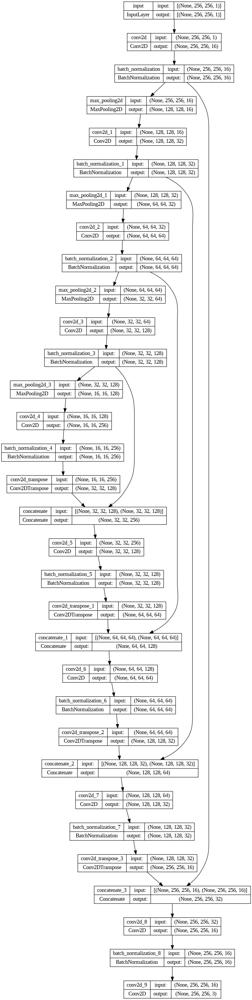

In [ ]:
from keras.utils import plot_model
plot_model(model,show_shapes=True)

In [ ]:
callbacks = [
    EarlyStopping(patience=5, verbose=1),
    ReduceLROnPlateau(factor=0.1, patience=5, min_lr=0.00001, verbose=1),
    ModelCheckpoint('model_1.h5', verbose=1, save_best_only=True, save_weights_only=True)
]

In [ ]:
results = model.fit(train_generator, 
                epochs = 100, steps_per_epoch = train_steps,
                validation_data = val_generator, validation_steps = val_steps,
                callbacks = callbacks)	

Epoch 1/100
928/928 [==============================] - ETA: 0s - loss: 0.7103 - accuracy: 0.8539
Epoch 1: val_loss improved from inf to 0.69176, saving model to model_1.h5
928/928 [==============================] - 548s 584ms/step - loss: 0.7103 - accuracy: 0.8539 - val_loss: 0.6918 - val_accuracy: 0.8889 - lr: 0.0010
Epoch 2/100
928/928 [==============================] - ETA: 0s - loss: 0.6696 - accuracy: 0.8972
Epoch 2: val_loss improved from 0.69176 to 0.67234, saving model to model_1.h5
928/928 [==============================] - 537s 579ms/step - loss: 0.6696 - accuracy: 0.8972 - val_loss: 0.6723 - val_accuracy: 0.8949 - lr: 0.0010
Epoch 3/100
928/928 [==============================] - ETA: 0s - loss: 0.6616 - accuracy: 0.9060
Epoch 3: val_loss did not improve from 0.67234
928/928 [==============================] - 536s 578ms/step - loss: 0.6616 - accuracy: 0.9060 - val_loss: 0.6995 - val_accuracy: 0.8888 - lr: 0.0010
Epoch 4/100
928/928 [==============================] - ETA: 0s -

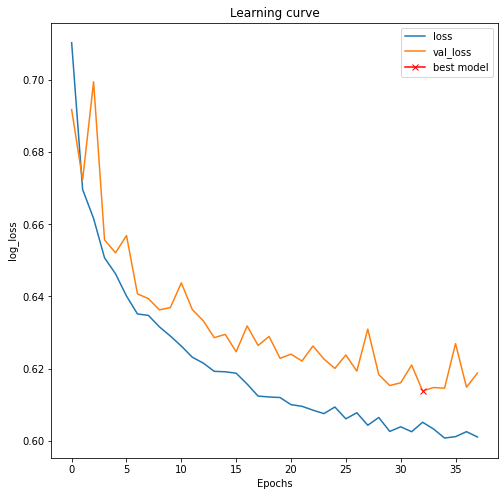

In [ ]:
# with batch normalization
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(results.history["loss"], label="loss")
plt.plot(results.history["val_loss"], label="val_loss")
plt.plot(np.argmin(results.history["val_loss"]), np.min(results.history["val_loss"]), marker="x", color="r", label="best model")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend();

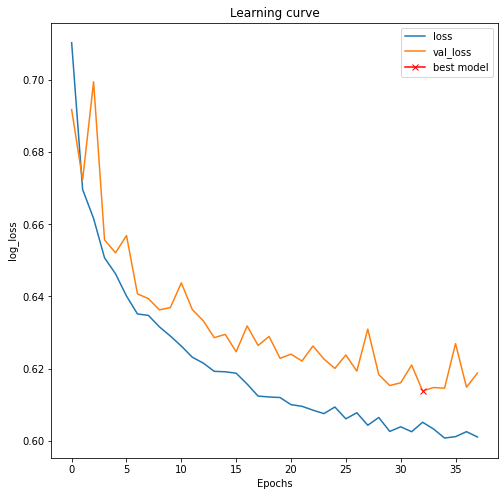

In [ ]:
# without batch normalization
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(results.history["loss"], label="loss")
plt.plot(results.history["val_loss"], label="val_loss")
plt.plot(np.argmin(results.history["val_loss"]), np.min(results.history["val_loss"]), marker="x", color="r", label="best model")
plt.xlabel("Epochs")
plt.ylabel("log_loss")
plt.legend();